In [1]:
from tqdm import tqdm_notebook as tqdm

In [2]:
import numpy as np
import pandas as pd
from glob import glob as glob

In [3]:
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, RobustScaler, PowerTransformer, QuantileTransformer
from sklearn.model_selection import ParameterGrid, KFold

In [4]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
tf.__version__

'2.2.0'

In [5]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')
sns.set_context('notebook')

/anaconda3/envs/neuro/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# 1. Data Preparation

In [6]:
# Load target values and corresponding scaler
targets = pd.read_csv('datasets/targets.csv')
targets = targets.rename(columns={'Unnamed: 0': 'Id'}).set_index('Id')
feature_transform = True

import joblib
scaler_targets = joblib.load('datasets/targets_scaler.pkl')

In [7]:
# Extract ID for train and test set
train_id = targets.index.values
sample_submission = pd.read_csv('sample_submission.csv')
test_id = np.unique(sample_submission.Id.str.split('_', expand=True)[0].astype('int'))

# 2. Modeling

In [8]:
def load_dataset(dataset_id):

    # Load dataset
    X_tr = pd.read_csv('datasets/%s_train.csv' % dataset_id)
    X_te = pd.read_csv('datasets/%s_test.csv' % dataset_id).drop(columns='Id').values

    # Specify target
    y = pd.read_csv('datasets/targets.csv')
    y = y.rename(columns={'Unnamed: 0': 'Id'}).set_index('Id')
    y_tr = y.iloc[X_tr.index]

    # Remove missing values
    missval = y_tr.isnull().values.sum(axis=1)>0
    idx = ~missval
    X_tr = X_tr[idx].drop(columns='Id').values
    y_tr = y_tr[idx].values
    print('Removing %s missing values from target dataset.' % missval.sum())
    
    return X_tr, X_te, y_tr, idx

In [9]:
class CustomLoss(keras.losses.Loss):
    def __init__(self, scale=[1, 1, 1, 1, 1], mean=[0, 0, 0, 0, 0], name="custom_loss"):
        super().__init__(name=name)
        self.scale = np.array(scale, dtype='float32')
        self.mean = np.array(mean, dtype='float32')

    @tf.function
    def call(self, y_true, y_pred):
        y_true = tf.math.add(tf.math.multiply(self.scale, y_true), self.mean)
        y_pred = tf.math.add(tf.math.multiply(self.scale, y_pred), self.mean)
        y_true = tf.transpose(tf.stack([
            y_true[:, 0],
            tf.math.pow(y_true[:, 1], 1./1.5),
            tf.math.pow(y_true[:, 2], 1./1.5),
            tf.math.pow(y_true[:, 3], 1./1.5),
            tf.math.pow(y_true[:, 4], 1./1.5)]))
        y_pred = tf.transpose(tf.stack([
            y_pred[:, 0],
            tf.math.pow(y_pred[:, 1], 1./1.5),
            tf.math.pow(y_pred[:, 2], 1./1.5),
            tf.math.pow(y_pred[:, 3], 1./1.5),
            tf.math.pow(y_pred[:, 4], 1./1.5)]))
        scores = tf.math.divide(tf.math.reduce_sum(tf.math.abs(y_true - y_pred), axis=0),
                                tf.math.reduce_sum(y_true, axis=0))
        weights = np.array([.3, .175, .175, .175, .175], dtype='float32')
        return tf.math.reduce_sum(tf.math.multiply(weights, scores))

In [10]:
def build_model(input_size=100,
                activation='relu',
                dropout=0.5,
                kernel_initializer='glorot_uniform',
                optimizer='adam',
                use_batch=True,
                use_dropout=True,
                hidden=(32, 16)):

    # Specify layer structure
    inputs = keras.Input(shape=input_size)
    
    for i, h in enumerate(hidden):
        if i==0:
            x = layers.Dense(h, kernel_initializer=kernel_initializer)(inputs)
        else:
            x = layers.Dense(h, kernel_initializer=kernel_initializer)(x)
        if use_batch:
            x = layers.BatchNormalization()(x)
        x = layers.Activation(activation)(x)

    # Add Dropout layer if requested
    if use_dropout:
        x = layers.Dropout(dropout)(x)

    outputs = layers.Dense(5)(x)
    
    # Create Model
    model = keras.Model(inputs, outputs)

    # Define loss function, optimizer and metrics to track during training
    model.compile(
        optimizer = optimizer,
        loss = CustomLoss(scale=scaler_targets.scale_, mean=scaler_targets.mean_),
        metrics=['mae', 'mse']
    )
    return model

In [11]:
def create_grid(input_size=0):

    # Define parameter grid
    param_grid = [
    { 
        'scaler': [RobustScaler(),
                   PowerTransformer()
                   ],
        'pca': [None, PCA(0.99)],
        'nn__input_size': [input_size],
        'nn__optimizer': ['adagrad'], #['rmsprop', 'adam', 'nadam', 'adagrad', 'sgd'],
        'nn__activation': ['softsign', 'swish', 'sigmoid', 'tanh'], #['elu', 'relu', 'selu', 'softplus', 'softsign', 'swish', 'sigmoid', 'hard_sigmoid', 'linear', 'tanh'],
        'nn__hidden': [(256, 64, 16),
                       (128, 16),
                       (32,)
                       ],
        'nn__dropout': [0.2],
        'nn__kernel_initializer': ['uniform'], #['glorot_uniform', 'normal', 'uniform'],
        'nn__use_batch': [True],
        'nn__use_dropout': [True],
        'batch_size': [64],
        'epochs': [50],
    }
    ]
    
    # Create Parameter Grid and return it
    grids = ParameterGrid(param_grid)
    return grids

In [12]:
def run_grid(grid, X_tr, X_te, y_tr, cv=4):
    
    # Scale data
    if grid['scaler']:
        x_train = grid['scaler'].fit_transform(X_tr)
        x_test = grid['scaler'].transform(X_te)

        # Apply PCA
        if grid['pca']:
            pca = grid['pca']
            x_train = pca.fit_transform(x_train)
            x_test = pca.transform(x_test)
            grid['nn__input_size'] = x_train.shape[1]
    else:
        x_train = X_tr.copy()
        x_test = X_te.copy()
    print(grid)
        
    # Create callback object
    callbacks = [keras.callbacks.EarlyStopping(
        monitor="loss", min_delta=1e-5, patience=5, verbose=1)]

    # Build NN model
    nn_grid ={}
    for k in grid.keys():
        if 'nn__' in k:
            nn_grid[k[4:]] = grid[k]

    # Run NN fit on multiple folds
    history_runs = {'loss': [], 'val_loss': []}
    kfold = KFold(n_splits=cv, shuffle=True)
    for train_id, val_id in kfold.split(x_train):

        # Prepare data for split
        x_train_k = x_train[train_id]
        x_val_k = x_train[val_id]

        y_train_k = y_tr[train_id]
        y_val_k = y_tr[val_id]

        # Prepare model
        model = build_model(**nn_grid)

        # Fit model
        history = model.fit(
            x_train_k,
            y_train_k,
            validation_data=(x_val_k, y_val_k),
            epochs=grid['epochs'],
            batch_size=grid['batch_size'],
            #callbacks=callbacks,
            shuffle=True, verbose=0
        )
        history_runs['loss'].append(history.history['loss'])
        history_runs['val_loss'].append(history.history['val_loss'])

    # Compute mean and standard deviation
    history_runs['loss_mean'] = pd.DataFrame(history_runs['loss']).T.mean(axis=1).values
    history_runs['val_loss_mean'] = pd.DataFrame(history_runs['val_loss']).T.mean(axis=1).values
    history_runs['loss_std'] = pd.DataFrame(history_runs['loss']).T.std(axis=1).values
    history_runs['val_loss_std'] = pd.DataFrame(history_runs['val_loss']).T.std(axis=1).values
    
    return x_train, x_test, history_runs, model

In [13]:
def extract_predictions(x_train, x_test, model, targets, truncate_top=5):

    # Store predictions in dictionary
    res = {}
    res['tr'] = model.predict(x_train)
    res['te'] = model.predict(x_test)

    """
    # Assign age to correct bin
    if target == 'age':
        age_values = np.unique(targets.age)
        for t in ['tr', 'te']:
            age_pred_tr = res['%s' % t]
            for i, a in enumerate(age_pred_tr):
                age_pred_tr[i] = age_values[np.argmin(np.abs(a-age_values))]
    """

    return res['tr'], res['te']

In [14]:
def plot_history_and_predictions(history, pred_tr, pred_te, y_tr, cutoff=1):

    # Create subplot grid
    fig = plt.figure(constrained_layout=True, figsize=(15, 9))
    gs = fig.add_gridspec(3, 5)
    ax1 = fig.add_subplot(gs[0, :])
    ax2 = [fig.add_subplot(gs[1, i]) for i in range(5)]
    ax3 = [fig.add_subplot(gs[2, i]) for i in range(5)]

    # Plot history results
    ax1.plot(history['loss_mean'][cutoff:], label='train loss')
    ax1.plot(history['val_loss_mean'][cutoff:], label='val loss')

    # Quantify variance with ±std curves
    for l in ['loss', 'val_loss']:
        ax1.fill_between(np.arange(len(history['%s_mean'%l][cutoff:])),
                         history['%s_mean'%l][cutoff:]-history['%s_std'%l][cutoff:],
                         history['%s_mean'%l][cutoff:]+history['%s_std'%l][cutoff:],
                         alpha=0.3)
    ax1.set_title('Validation loss {:.4f} (mean last 5)'.format(
        np.mean(history['val_loss_mean'][-5:])
    ))
    ax1.set_xlabel('epoch')
    ax1.set_ylabel('loss value')
    ax1.legend()

    # Categories
    categories = ['age', 'domain1_var1', 'domain1_var2', 'domain2_var1', 'domain2_var2']

    # Plot discrepancy on training set
    for i, axt in enumerate(ax2):
        sns.regplot(x=pred_tr[:, i], y=y_tr[:, i], marker='.', ax=axt,
                    scatter_kws={'alpha': 0.5, 's': 10})
        axt.set_title('Prediction X_tr: %s' % categories[i])

    # Plot prediction distribution of test set
    for i, axt in enumerate(ax3):
        axt.plot(pred_tr[:, i], '.', alpha=0.5)
        axt.plot(pred_te[:, i], '.', alpha=0.3)
        axt.set_title('Prediction X_te: %s' % categories[i])
    
    plt.show()

In [15]:
def extract_score_info(history):
    tr_mean = np.round(np.mean(history['loss_mean'][-5:]), 6)
    te_mean = np.round(np.mean(history['val_loss_mean'][-5:]), 6)
    tr_std = np.round(np.std(history['loss_mean'][-5:]), 6)
    te_std = np.round(np.std(history['val_loss_mean'][-5:]), 6)
    return tr_mean, te_mean, tr_std, te_std

In [16]:
def run_prediction(targets, dataset_id='merge'):

    # Extract dataset
    X_tr, X_te, y_tr, idx = load_dataset(dataset_id)
    print('Size of dataset: ', X_tr.shape)

    # Create grid search object
    grids = create_grid(input_size=X_tr.shape[1])
    print('%0d grid points will be checked!' % len(grids))
    print('\n---Start_Grid_Exploration---\n')
 
    # Go through the grids
    preds_tr = []
    preds_te = []
    df_grids = []
    for gidx, grid in enumerate(tqdm(grids)):

        # Run grid
        print('%04d/%04d' % (gidx + 1, len(grids)))
        x_train, x_test, history, model = run_grid(grid, X_tr, X_te, y_tr)

        # Compute predictions
        pred_tr, pred_te = extract_predictions(x_train, x_test, model, targets, truncate_top=0)
        preds_tr.append(pred_tr)
        preds_te.append(pred_te)

        # Plot history results and predictions
        plot_history_and_predictions(history, pred_tr, pred_te, y_tr, cutoff=5)
        
        # Extract scores
        tr_mean, te_mean, tr_std, te_std = extract_score_info(history)
        print(tr_mean, te_mean, te_mean-tr_mean)
        
        # Store everything in a grid
        df_grid = pd.DataFrame(columns=grid.keys())
        for k in grid:
            df_grid.loc[0, k] = str(grid[k])
        df_grid.insert(0, 'tr_mean', tr_mean)
        df_grid.insert(1, 'te_mean', te_mean)
        df_grids.append(df_grid)

    # Summarize fit in datatable
    df_fit = pd.concat(df_grids).reset_index().drop(columns='index').sort_values('te_mean')
    display(df_fit)
    
    return preds_tr[df_fit.index[0]], preds_te[df_fit.index[0]], df_fit.iloc[0], idx, df_grid

In [17]:
def create_results_dataframe(predictions, scaler_targets, targets, test_id, feature_transform, res_type='te'):

    # Collect results
    results = predictions[res_type]

    # Reset scaling
    results = scaler_targets.inverse_transform(results)

    # Store results in Dataframe
    if res_type=='te':
        df_results = pd.DataFrame(results, columns=targets.columns)

    elif res_type=='tr':
        # Get location of missing values
        entries = predictions['miss']

        # Create dataframe and fill up missing value places with NaN
        df_results = pd.DataFrame(dict(zip(train_id[entries].astype('str'), results))).T
        df_results.columns = targets.columns

    # Reset feature transformation
    if feature_transform:
        for col in df_results.columns[1:]:
            df_results[col] = np.power(df_results[col], 1./1.5)

    """
    # Assign age to correct bin
    age_values = np.unique(scaler_targets.inverse_transform(targets)[:, 0])
    for i, a in enumerate(df_results.age):
        df_results.age[i] = age_values[np.argmin(np.abs(a-age_values))]
    """

    # Add ID back to test results
    if res_type=='_te':
        df_results.insert(0, 'Id', test_id)
        df_results.set_index('Id', inplace=True)
    
    return df_results

In [18]:
def save_results(predictions, scaler_targets, targets, test_id, feature_transform,
                 sample_submission, dataset_id, score_postfix):
    
    # Get results dataframe
    df_results_tr = create_results_dataframe(predictions, scaler_targets, targets,
                                             test_id, feature_transform, res_type='tr')
    df_results_te = create_results_dataframe(predictions, scaler_targets, targets,
                                             test_id, feature_transform, res_type='te')
    
    # Store test results in CSV file
    score_postfix = str(score_postfix)
    submission = sample_submission.copy()
    submission['Predicted'] = np.ravel(df_results_te)
    submission.to_csv('results/submission_nn-multi_%s_%s.csv' % (dataset_id, score_postfix), index=False)
    
    # Store dataframes in CSV files
    df_results_tr.to_csv('results/results_tr_nn-multi_%s_%s.csv' % (dataset_id, score_postfix), index=False)
    df_results_te.to_csv('results/results_te_nn-multi_%s_%s.csv' % (dataset_id, score_postfix), index=False)

    return df_results_tr, df_results_te

In [19]:
def plot_prediction_distributions(targets, scaler_targets, df_results_tr, df_results_te):
    
    # Recreate original target dataset
    df_results = pd.DataFrame(scaler_targets.inverse_transform(targets),
                              columns=targets.columns)

    # Reset feature transformation
    if feature_transform:
        for col in df_results.columns[1:]:
            df_results[col] = np.power(df_results[col], 1./1.5)

    # Compare target distributions of train and test set
    for c in df_results.columns:
        plt.figure(figsize=(5, 5))
        plt.title(c)
        plt.hist(df_results[c], bins=25, alpha=0.5, density=True)
        plt.hist(df_results_te[c], bins=25, alpha=0.5, density=True)
        plt.hist(df_results_tr[c], bins=25, alpha=0.5, density=True)
        plt.legend(['orig', 'test', 'train'])
        plt.show()

In [20]:
# Show list of available datasets
sorted(glob('datasets/*train.csv'))

['datasets/brain_corr_raw_train.csv',
 'datasets/brain_corr_train.csv',
 'datasets/brain_value_train.csv',
 'datasets/brain_voxel_train.csv',
 'datasets/fnc_train.csv',
 'datasets/ica_train.csv',
 'datasets/long_corr_train.csv',
 'datasets/long_extratree_train.csv',
 'datasets/long_merge_train.csv',
 'datasets/long_scaled_train.csv',
 'datasets/merge_ica_fnc_corr_train.csv',
 'datasets/merge_ica_fnc_train.csv',
 'datasets/merge_ica_fnc_value_train.csv',
 'datasets/merge_ica_fnc_voxel_train.csv',
 'datasets/merge_train.csv',
 'datasets/scaled_ica_fnc_corr_train.csv',
 'datasets/scaled_ica_fnc_train.csv',
 'datasets/scaled_ica_fnc_value_train.csv',
 'datasets/scaled_ica_fnc_voxel_train.csv',
 'datasets/short_corr_train.csv',
 'datasets/short_extratree_train.csv',
 'datasets/short_merge_train.csv',
 'datasets/short_scaled_train.csv']

Starting with dataset merge
Removing 440 missing values from target dataset.
Size of dataset:  (5385, 1404)
48 grid points will be checked!

---Start_Grid_Exploration---



0001/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


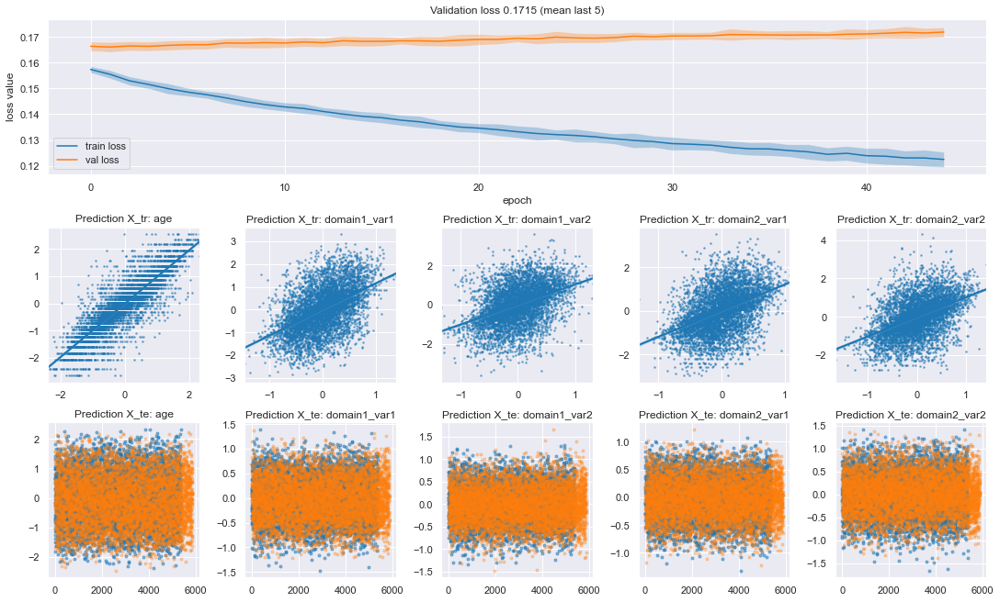

0.123211 0.171542 0.048331
0002/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


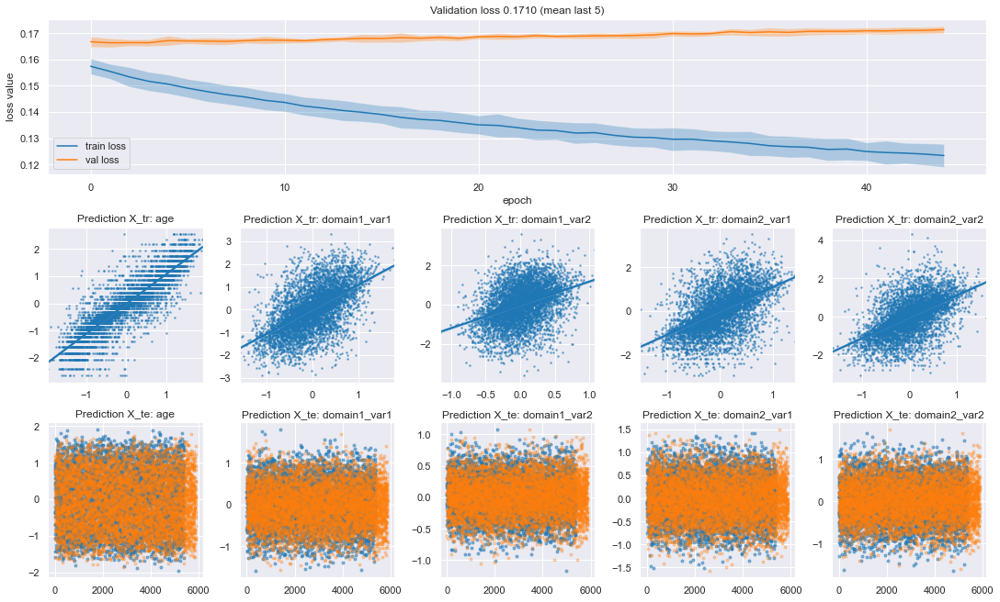

0.124282 0.171033 0.04675099999999999
0003/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


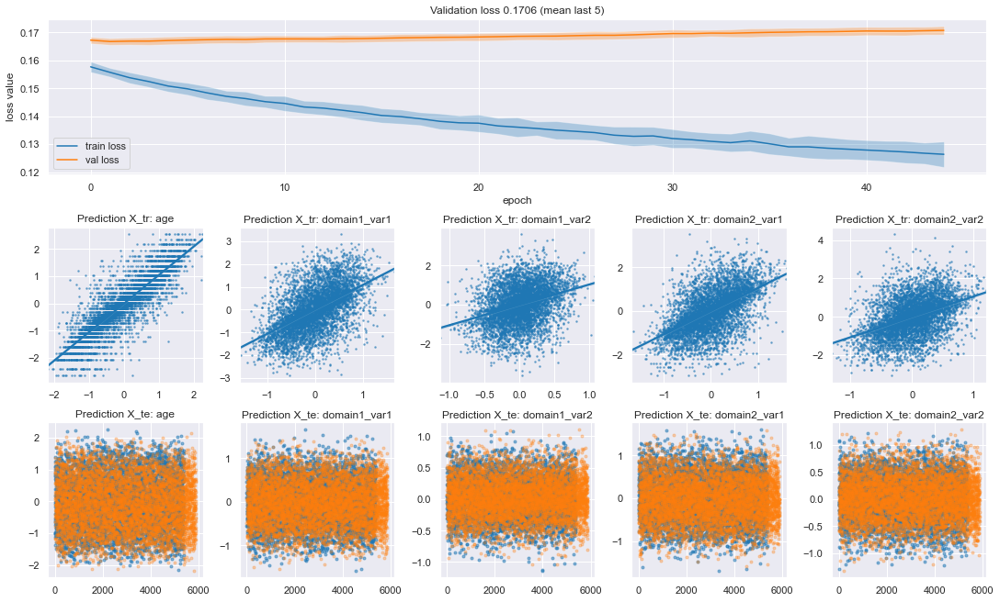

0.127151 0.17059 0.043439000000000005
0004/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


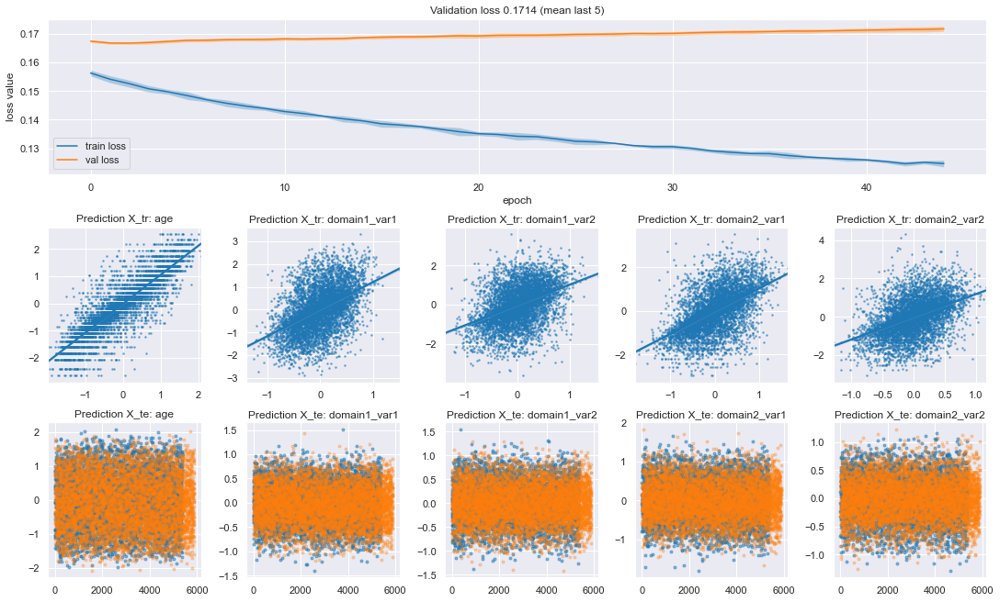

0.125229 0.171405 0.046175999999999995
0005/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


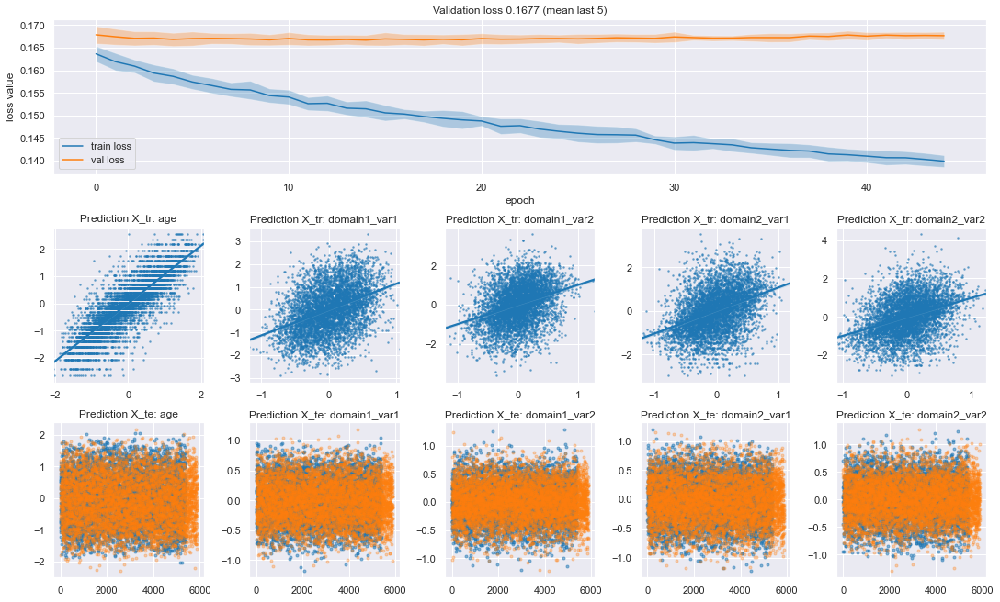

0.14049 0.167664 0.027174000000000004
0006/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


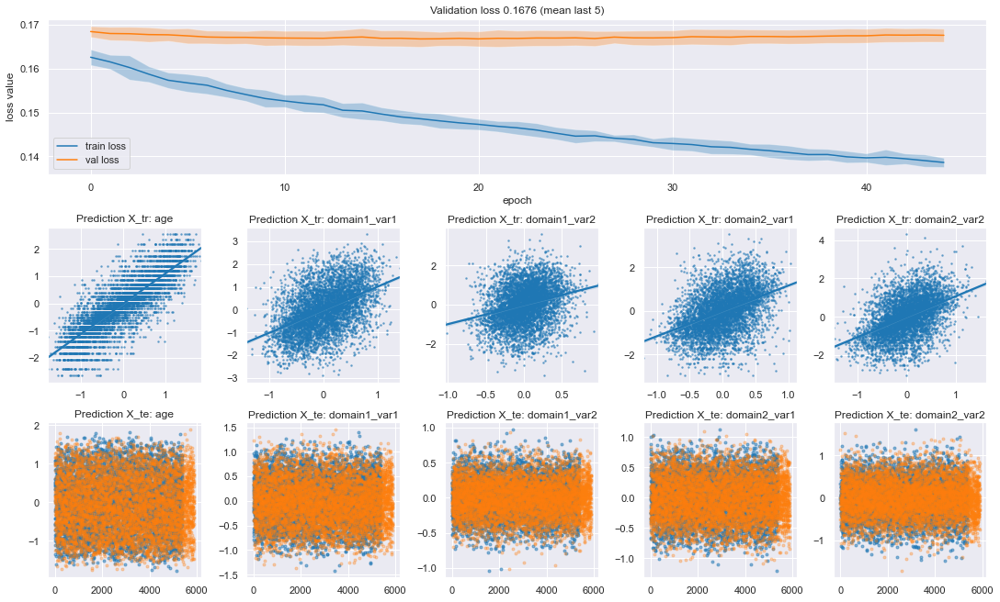

0.139332 0.167586 0.028254
0007/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


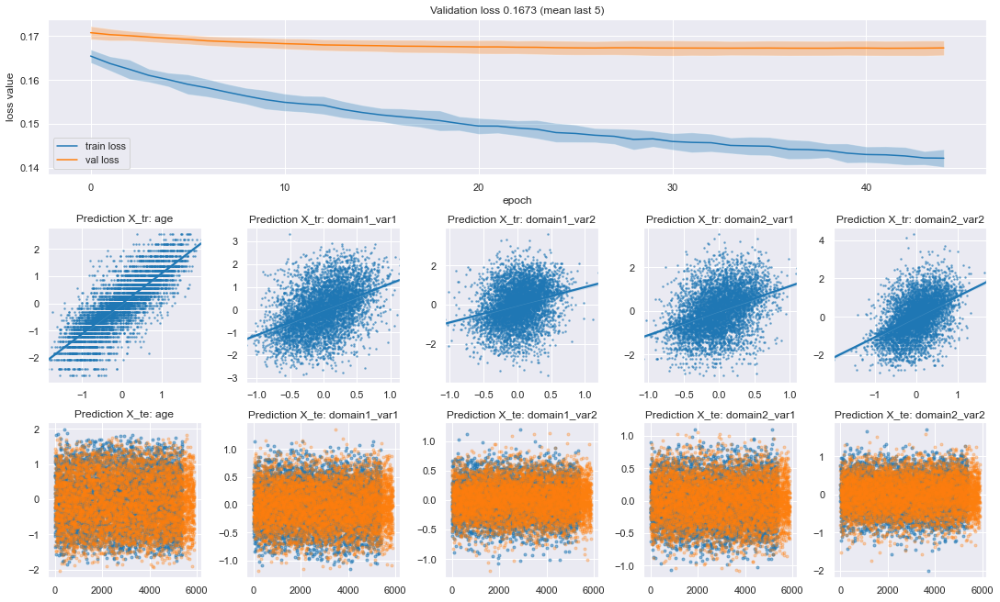

0.1426 0.167259 0.024658999999999986
0008/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


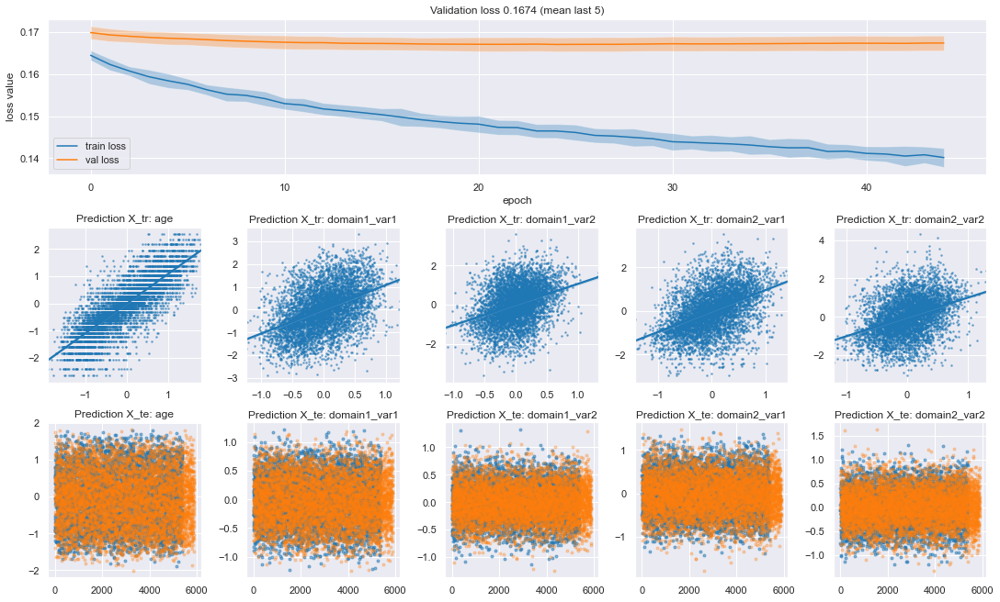

0.140736 0.167378 0.026642
0009/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


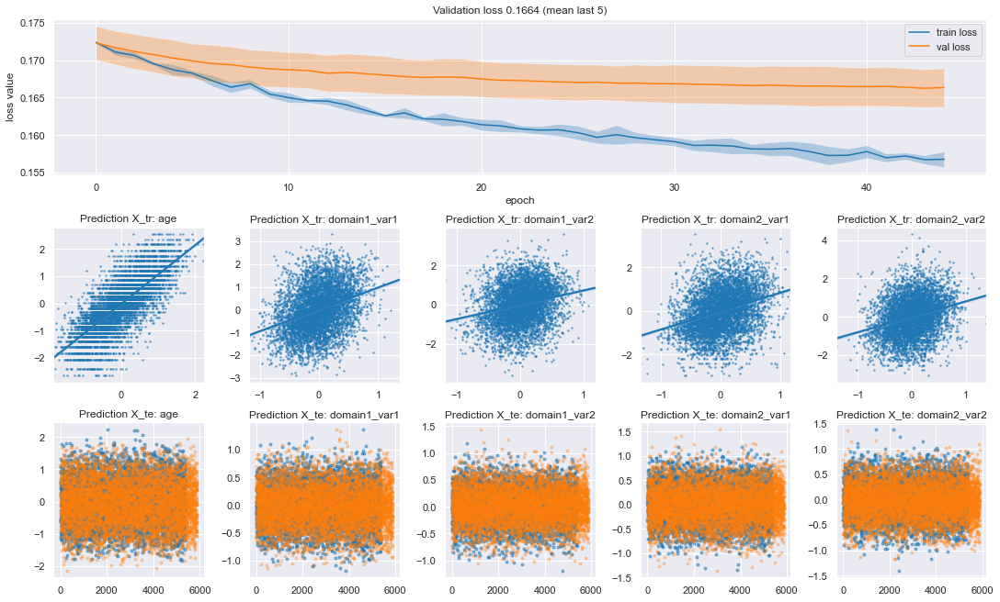

0.157098 0.166385 0.009287000000000017
0010/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


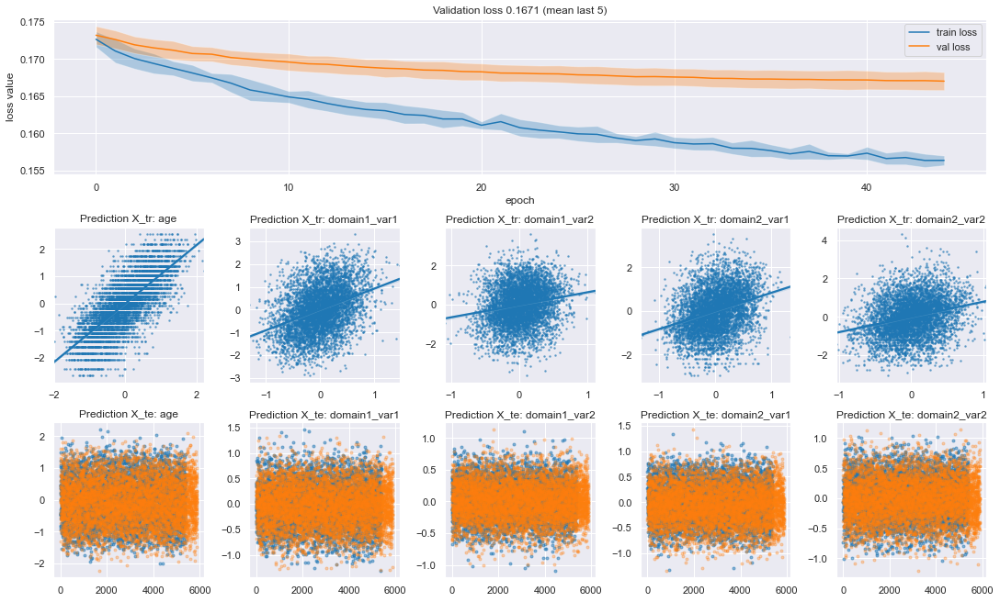

0.156684 0.167078 0.010394000000000014
0011/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


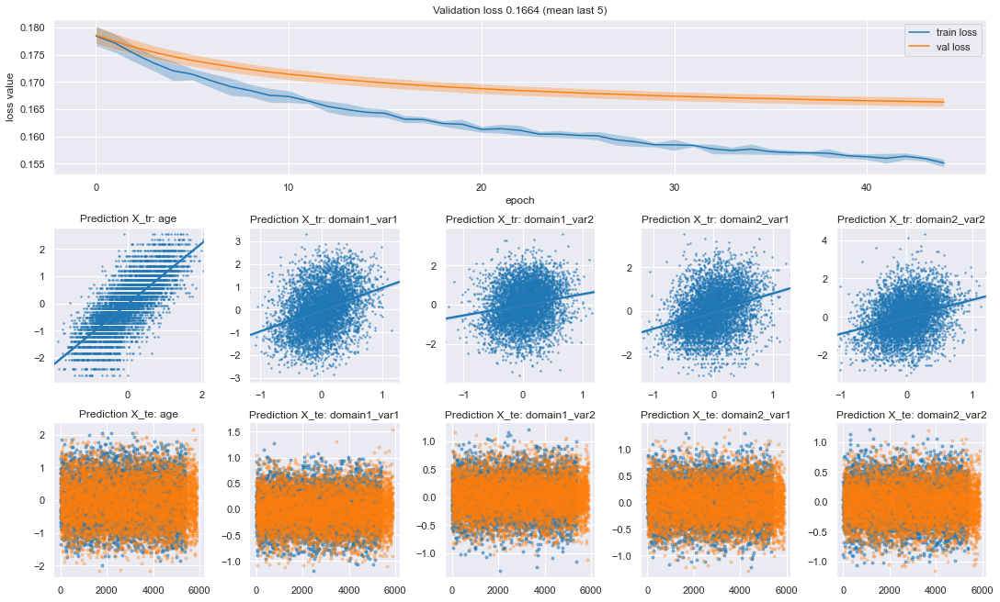

0.155926 0.166436 0.010509999999999992
0012/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


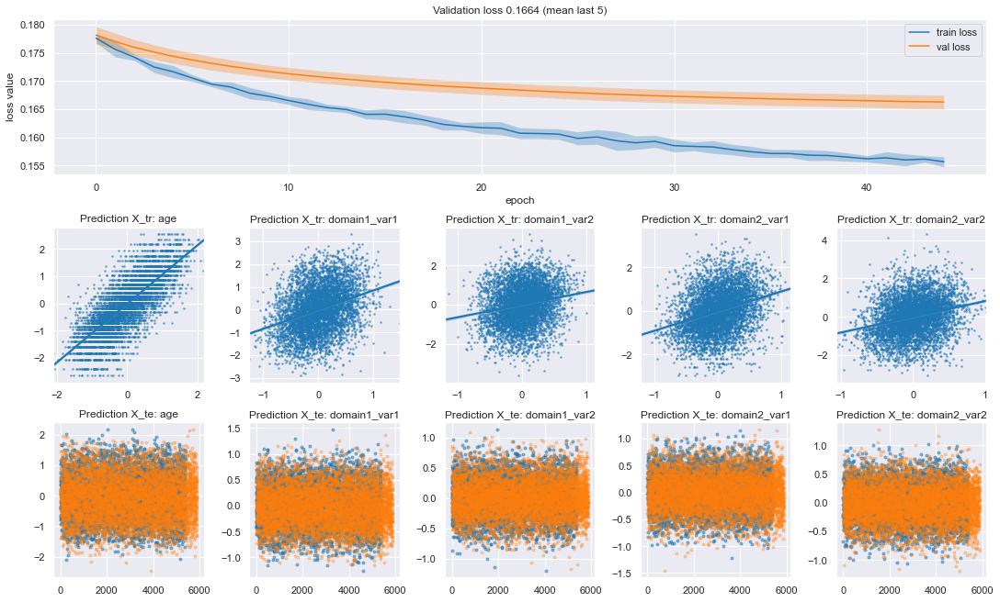

0.156078 0.166388 0.010310000000000014
0013/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


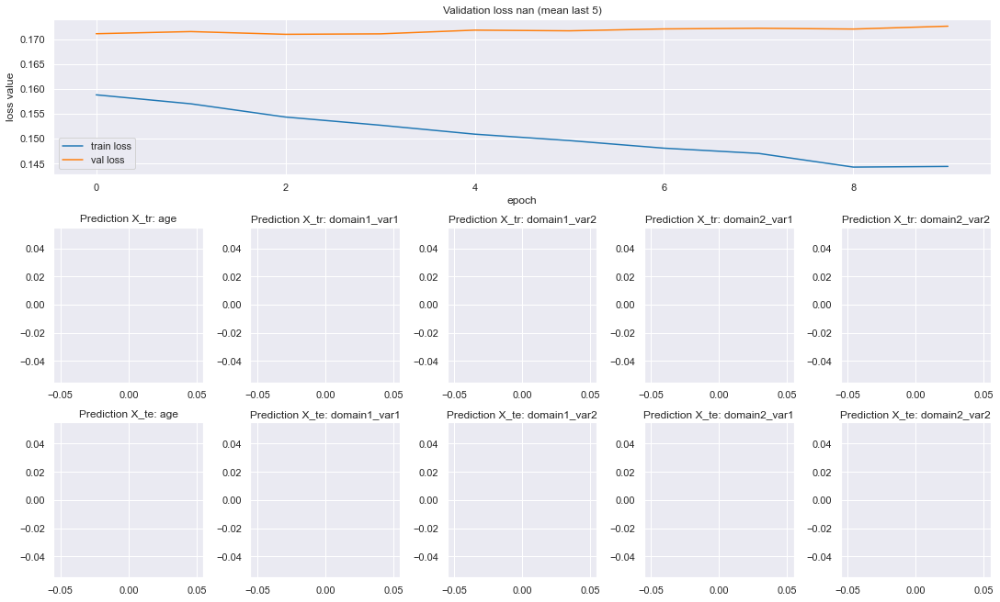

nan nan nan
0014/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


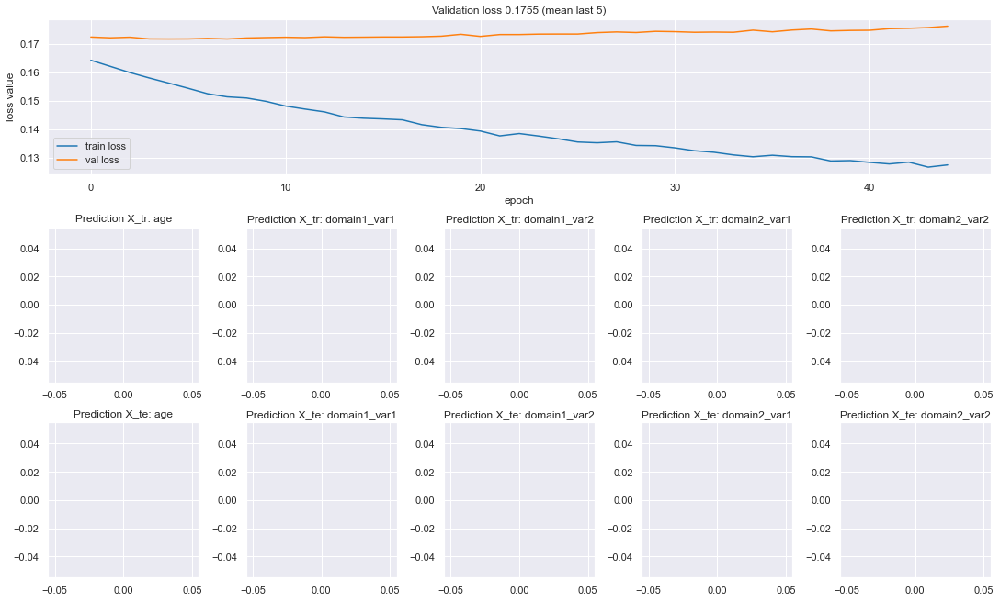

0.127689 0.175493 0.04780400000000001
0015/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


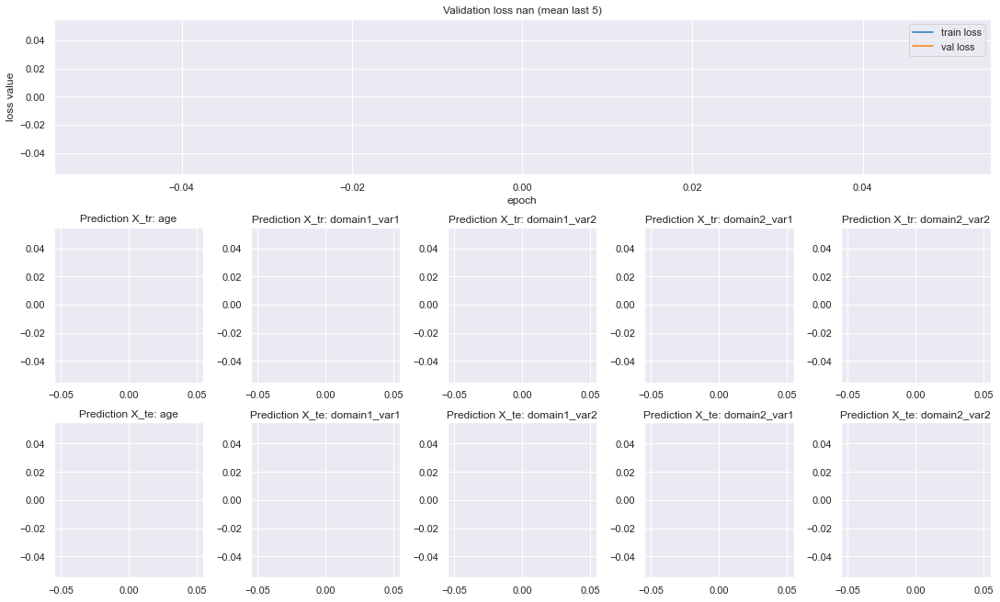

nan nan nan
0016/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


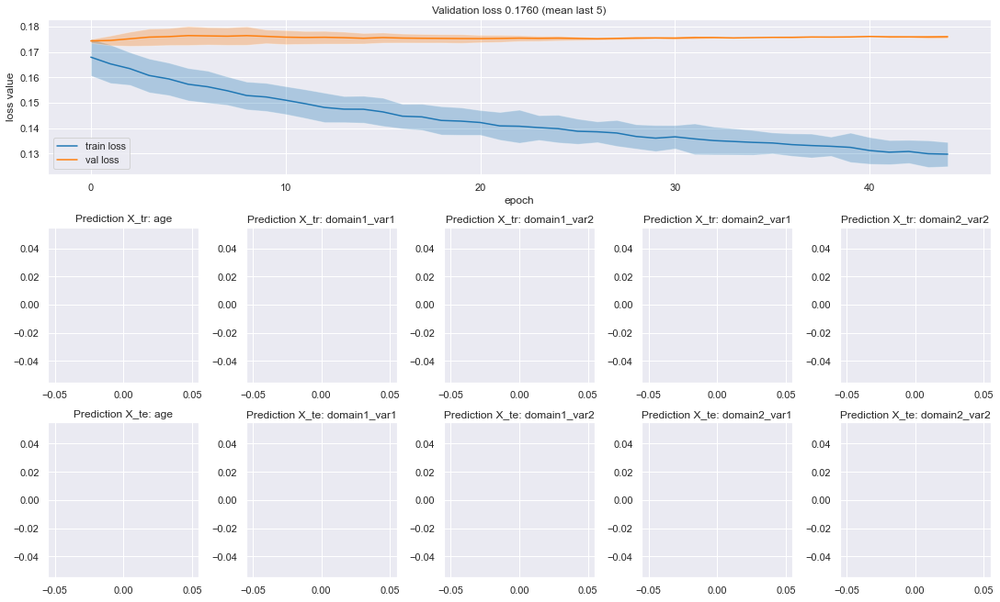

0.130441 0.176015 0.045574
0017/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


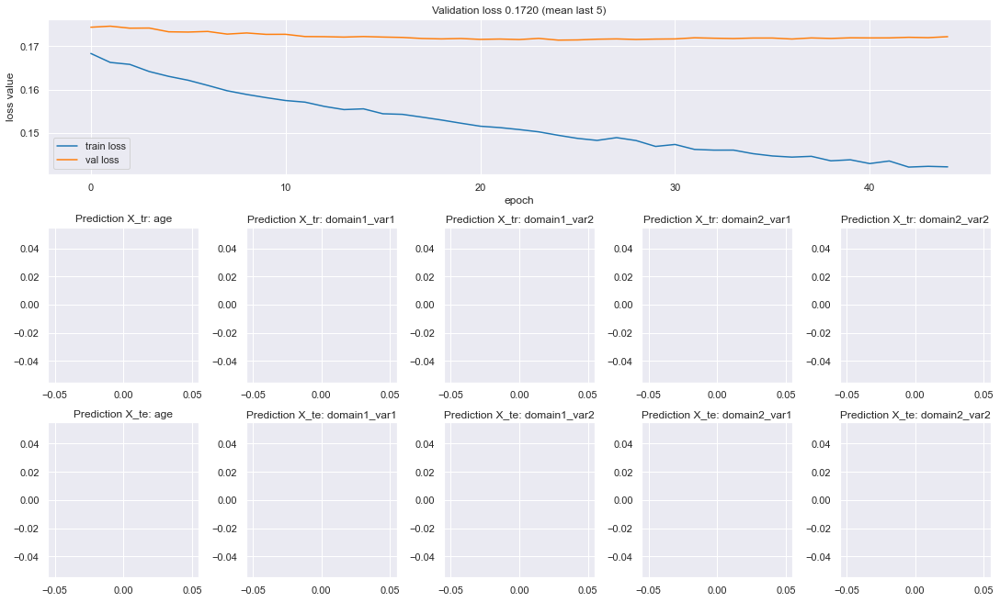

0.142579 0.172036 0.029456999999999983
0018/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


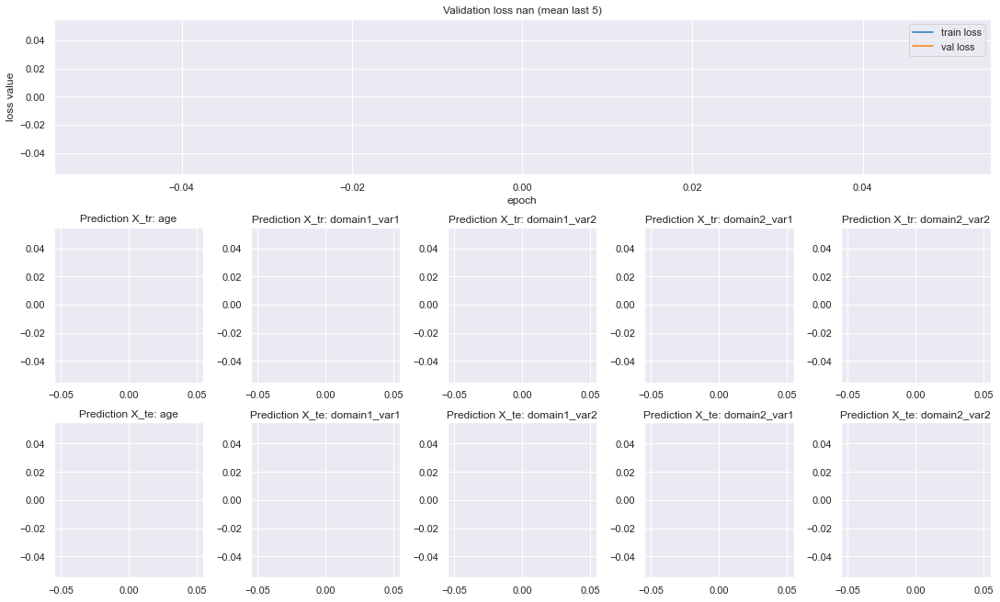

nan nan nan
0019/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


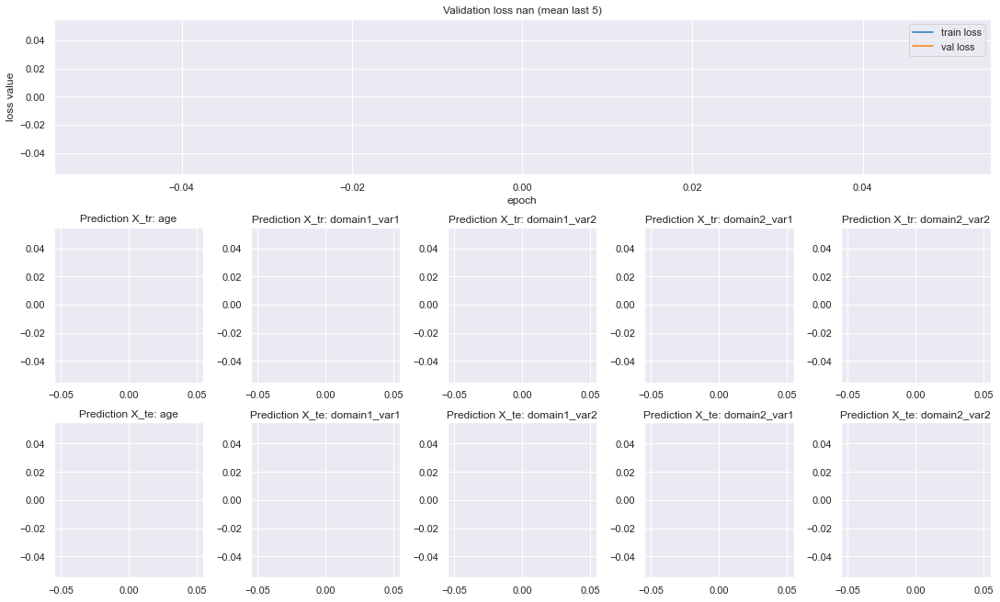

nan nan nan
0020/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


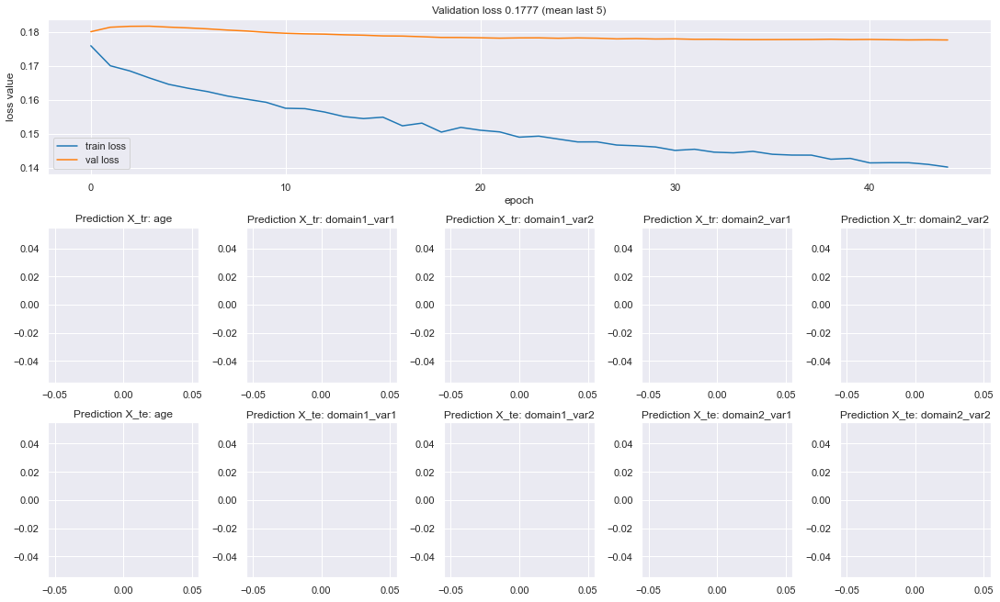

0.141087 0.177672 0.036585000000000006
0021/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


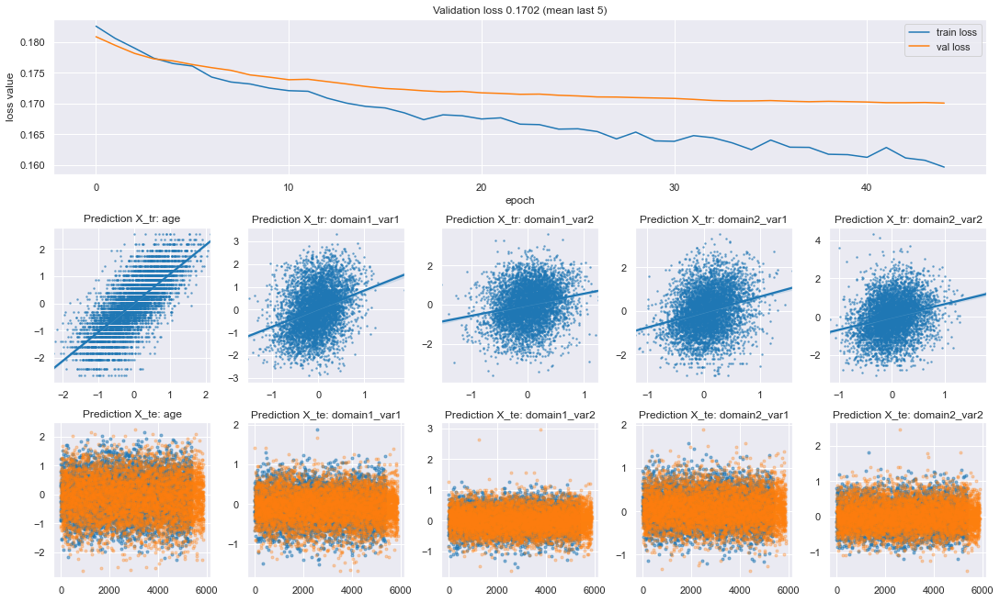

0.161169 0.170165 0.008996000000000004
0022/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


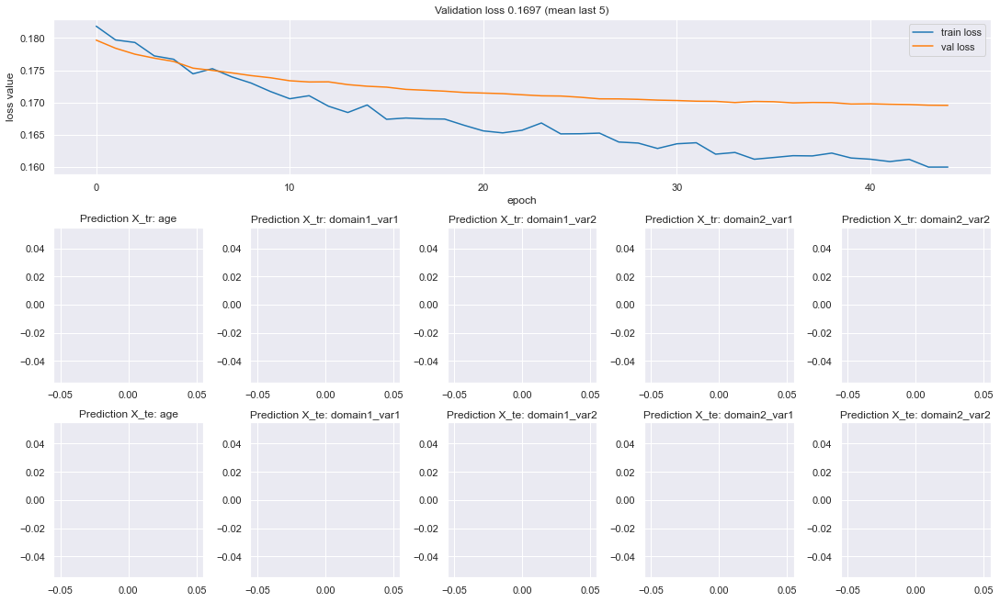

0.16065 0.169675 0.009025000000000005
0023/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


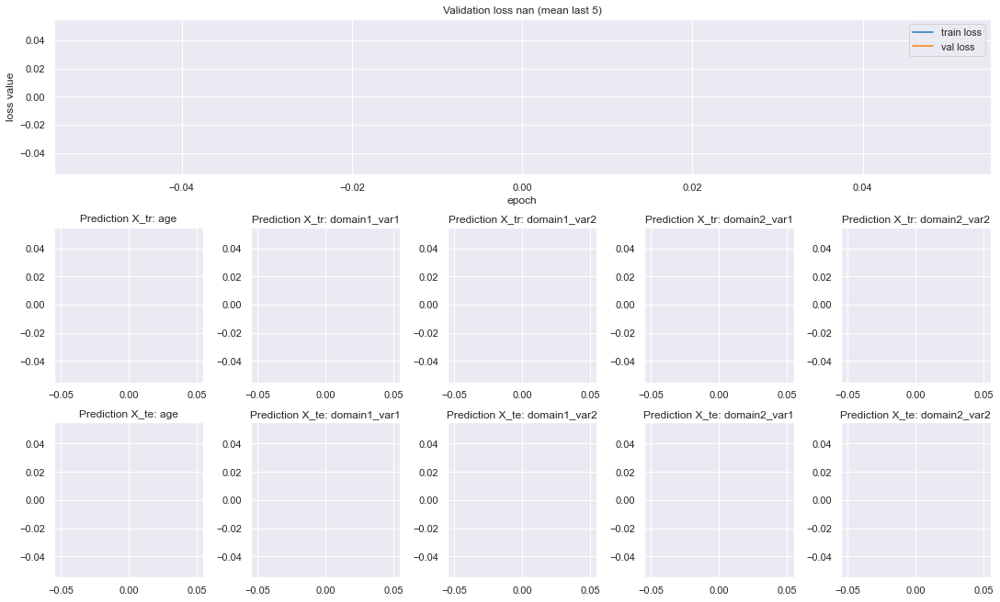

nan nan nan
0024/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


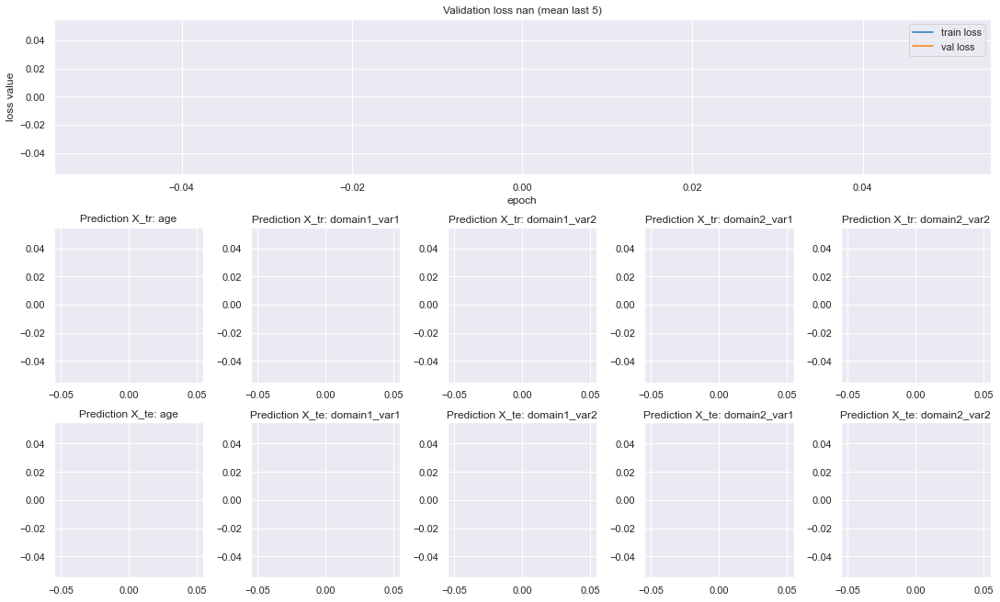

nan nan nan
0025/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


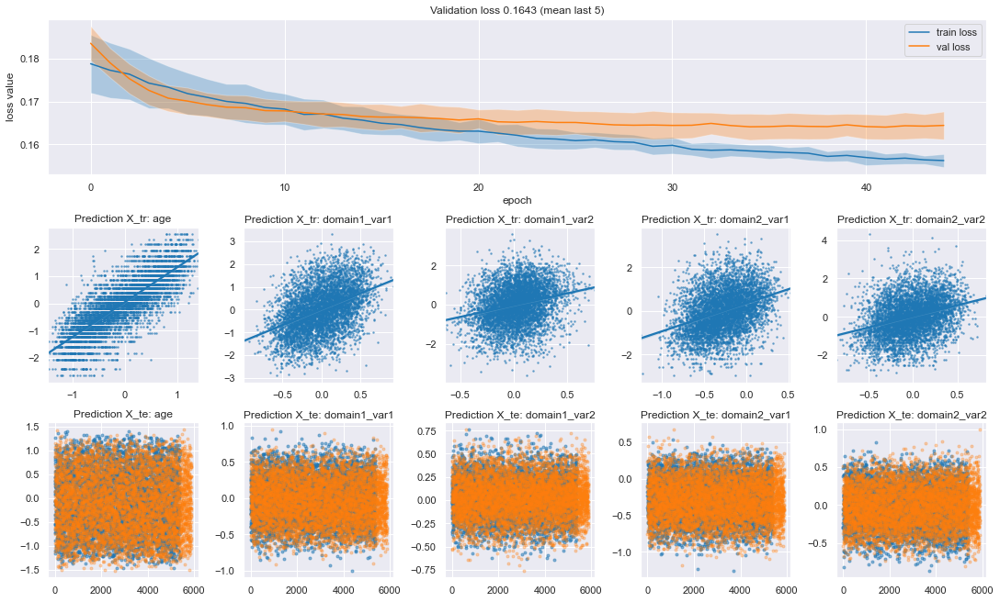

0.156636 0.164259 0.007622999999999991
0026/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


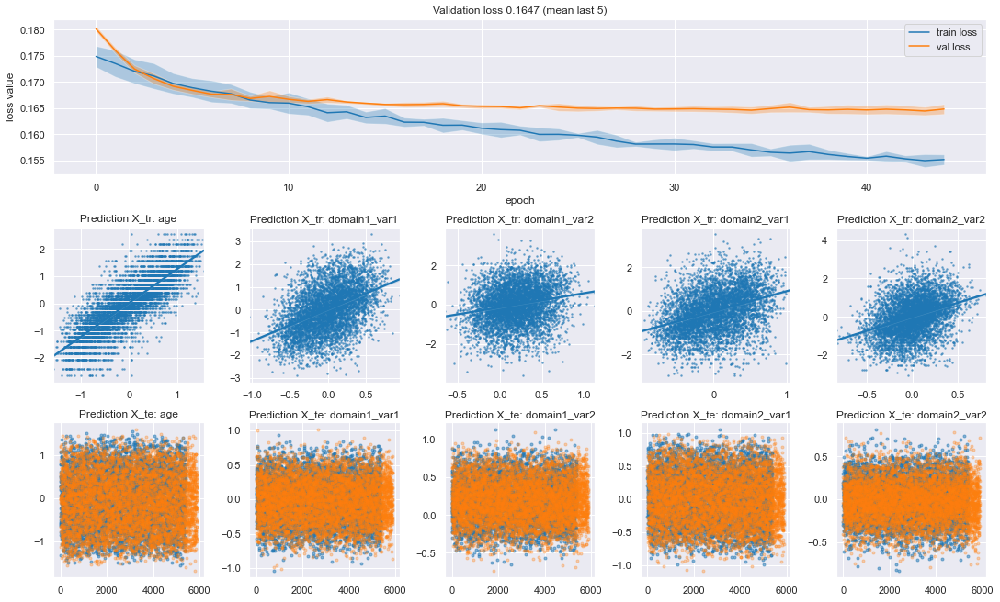

0.155301 0.164664 0.00936300000000001
0027/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


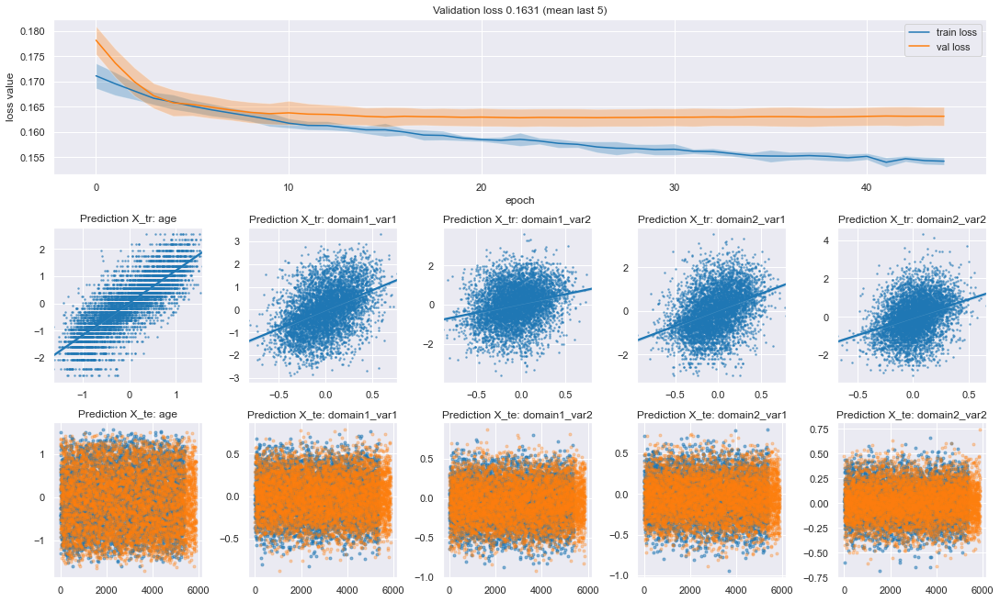

0.154505 0.163133 0.008627999999999997
0028/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


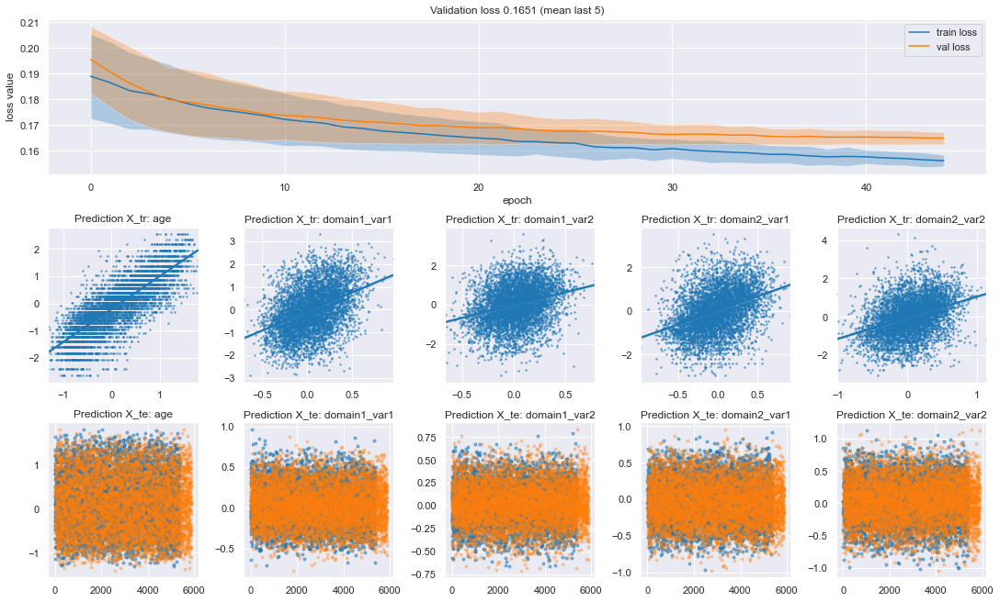

0.156928 0.165147 0.008218999999999976
0029/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


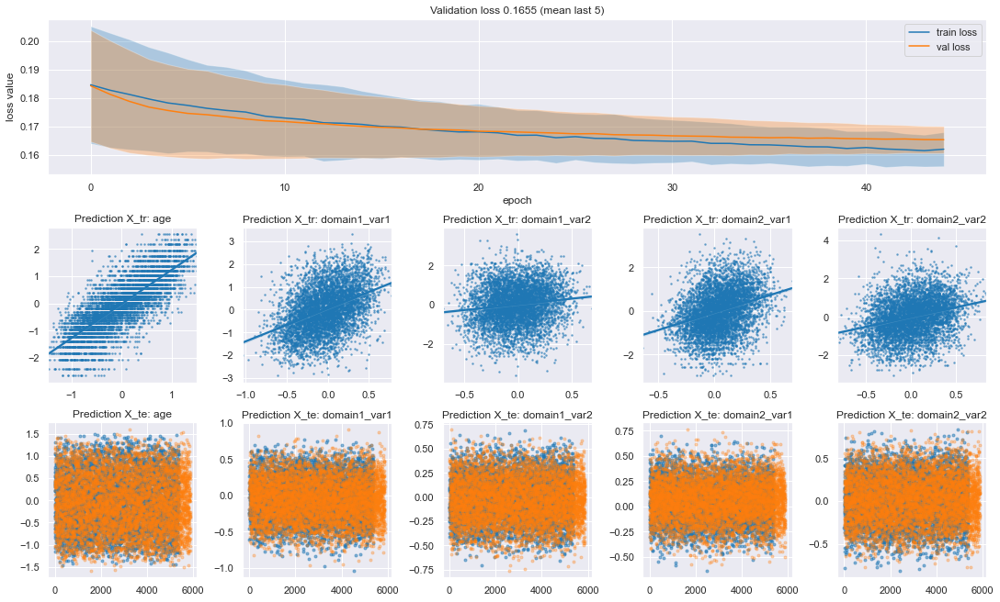

0.162044 0.165543 0.003499000000000002
0030/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


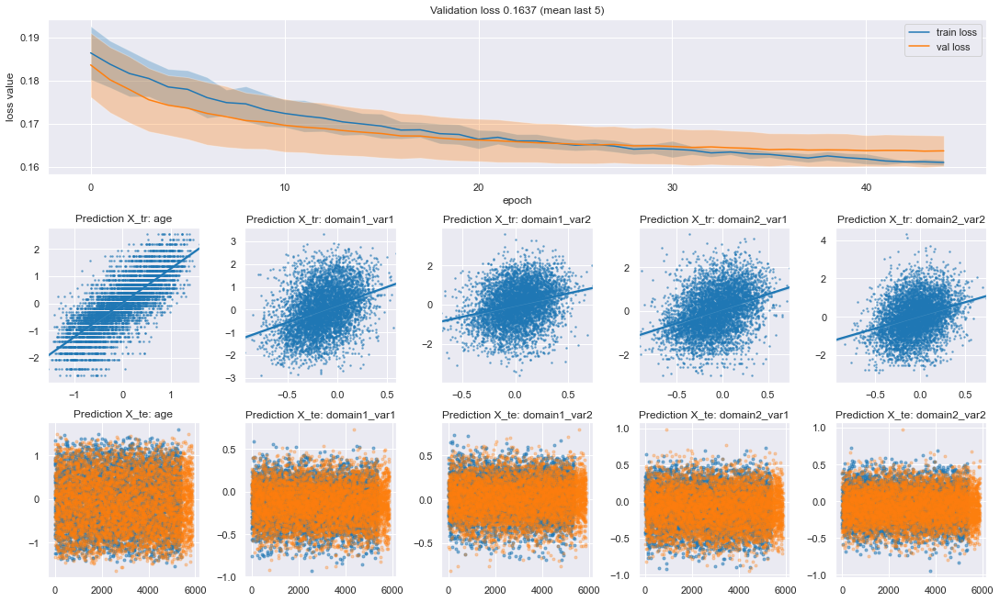

0.161298 0.163725 0.0024270000000000125
0031/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


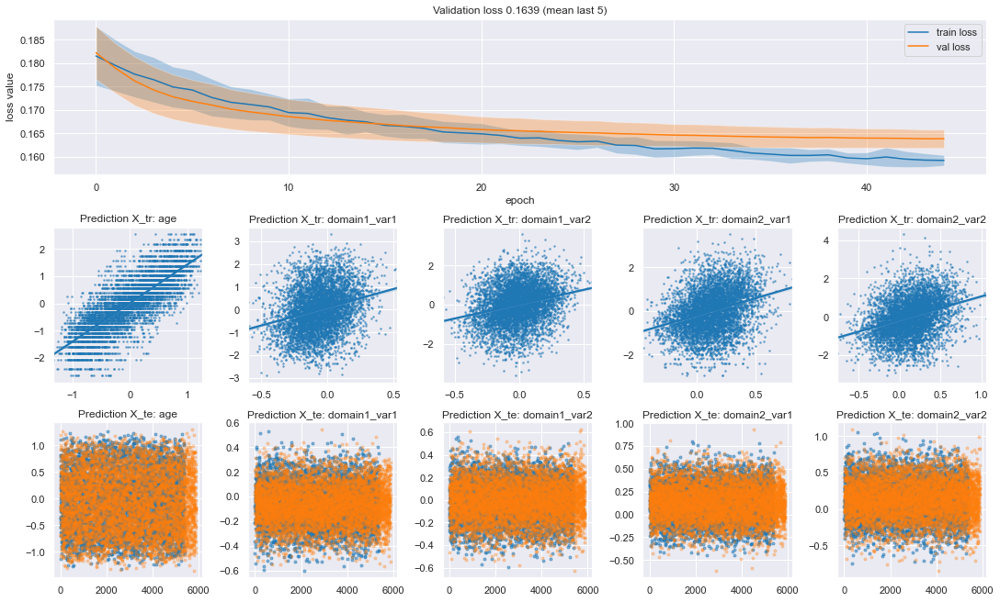

0.159487 0.163901 0.004414000000000001
0032/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


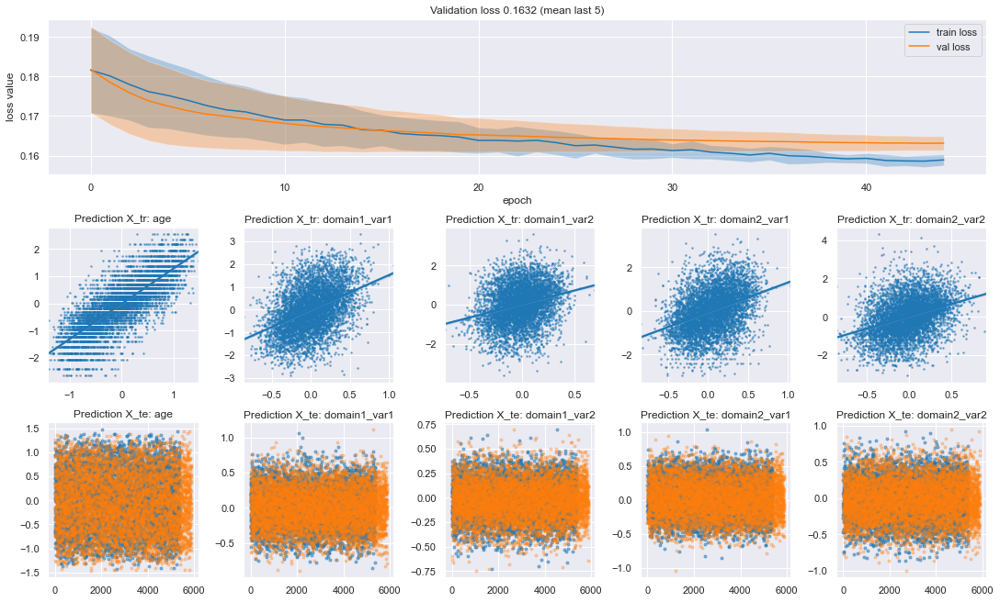

0.158838 0.163162 0.0043239999999999945
0033/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


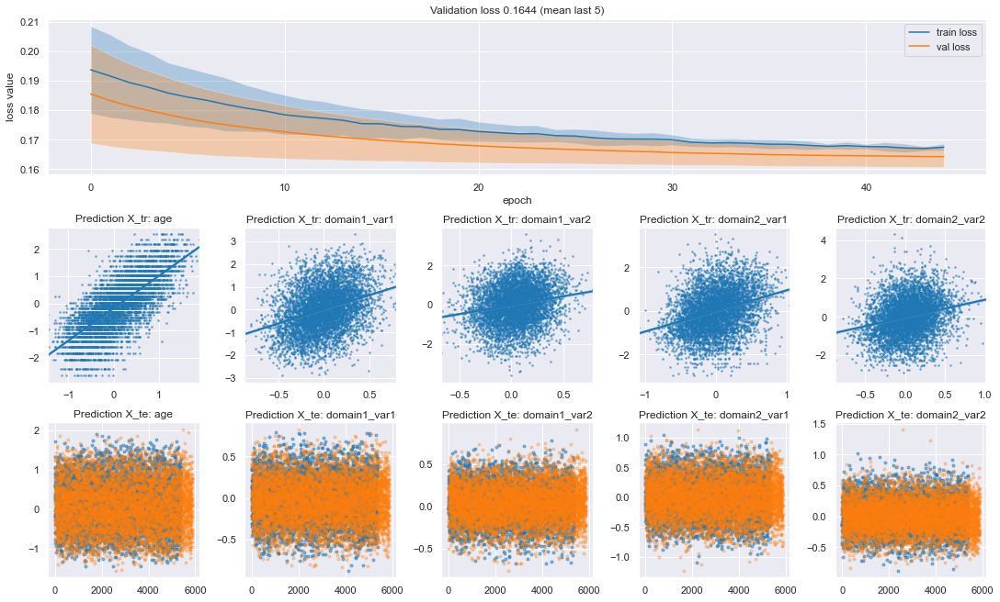

0.167376 0.164361 -0.00301499999999999
0034/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


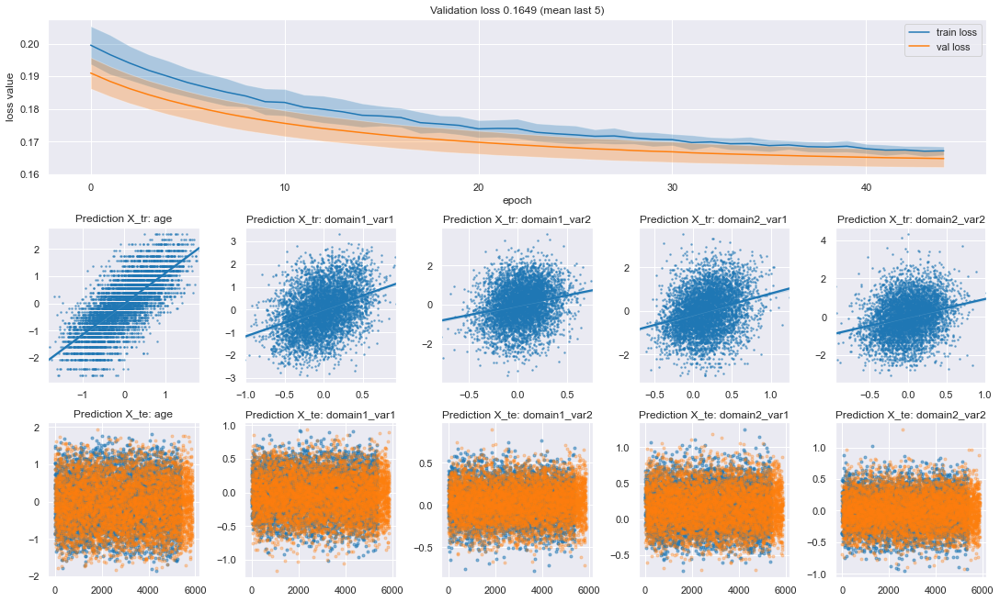

0.167342 0.164943 -0.0023989999999999845
0035/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


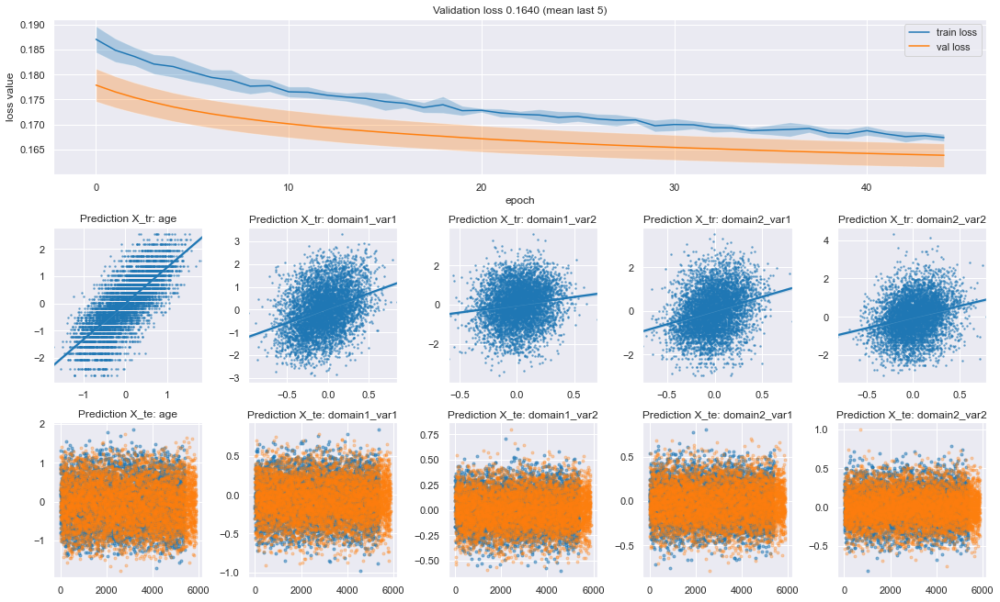

0.167922 0.164033 -0.003888999999999976
0036/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


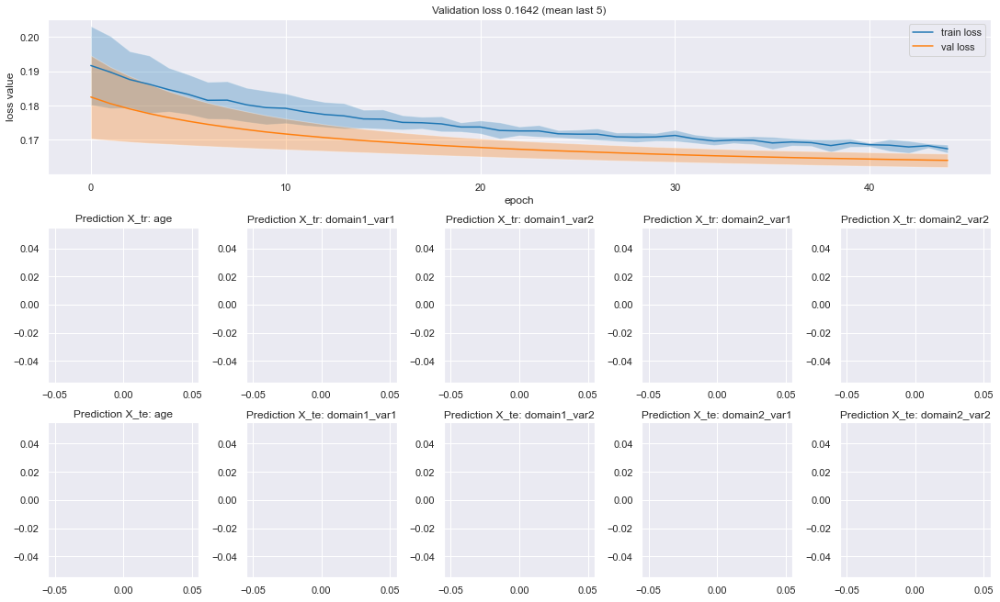

0.168158 0.164227 -0.00393099999999999
0037/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


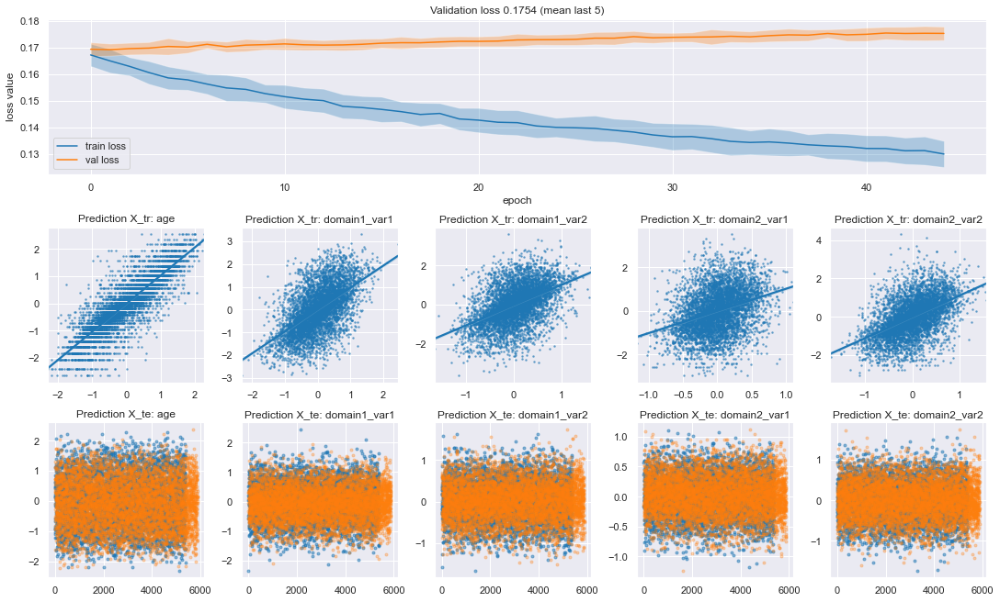

0.131423 0.175372 0.04394899999999999
0038/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


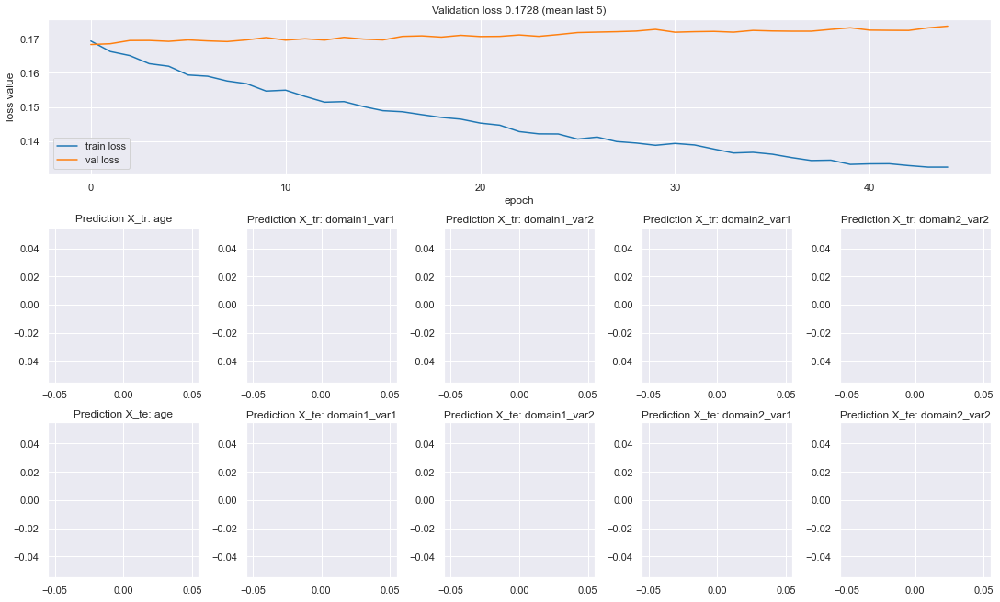

0.132853 0.17283 0.03997700000000001
0039/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


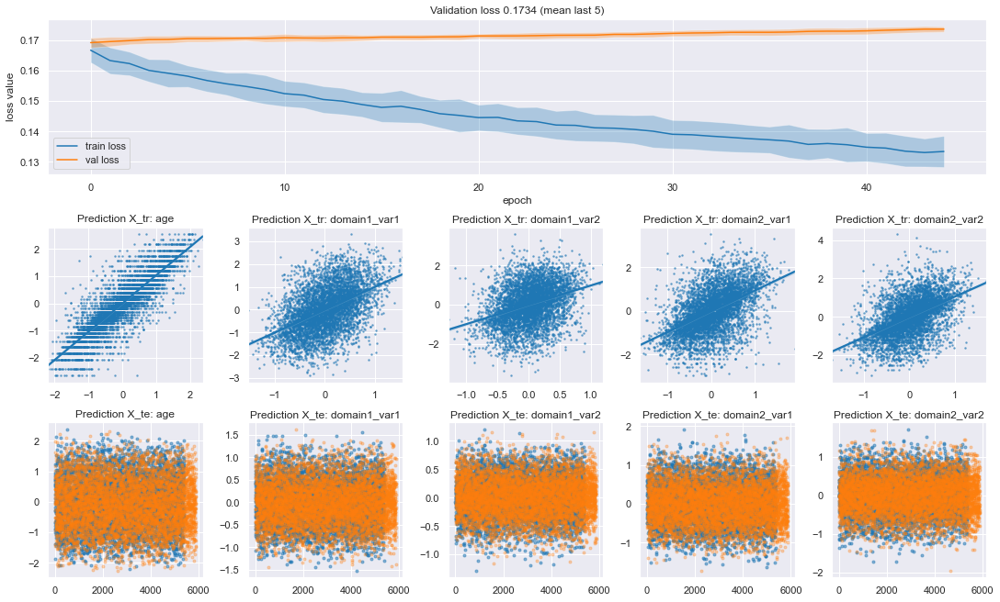

0.133879 0.173359 0.039480000000000015
0040/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


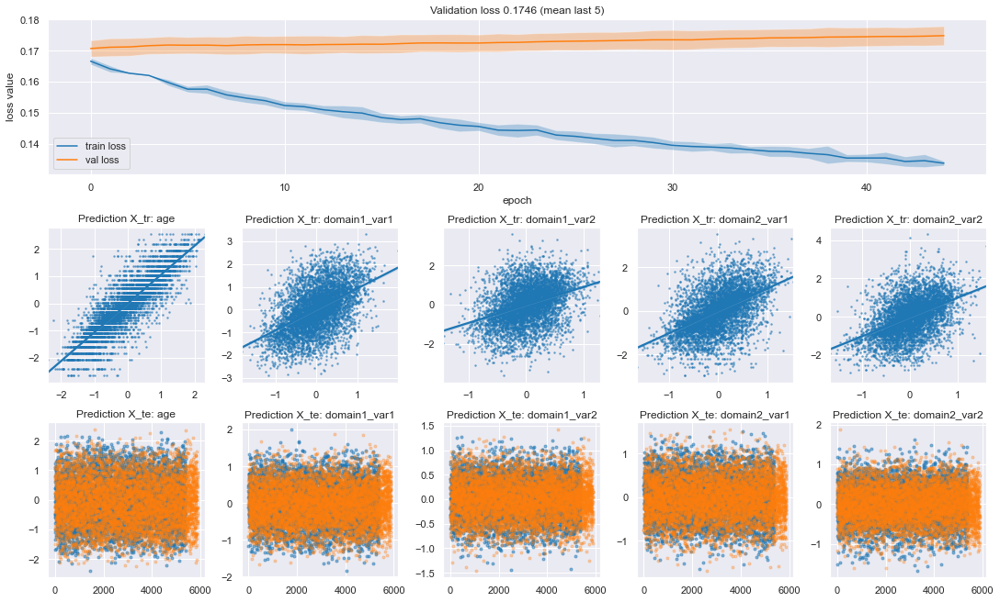

0.134705 0.174644 0.039939
0041/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


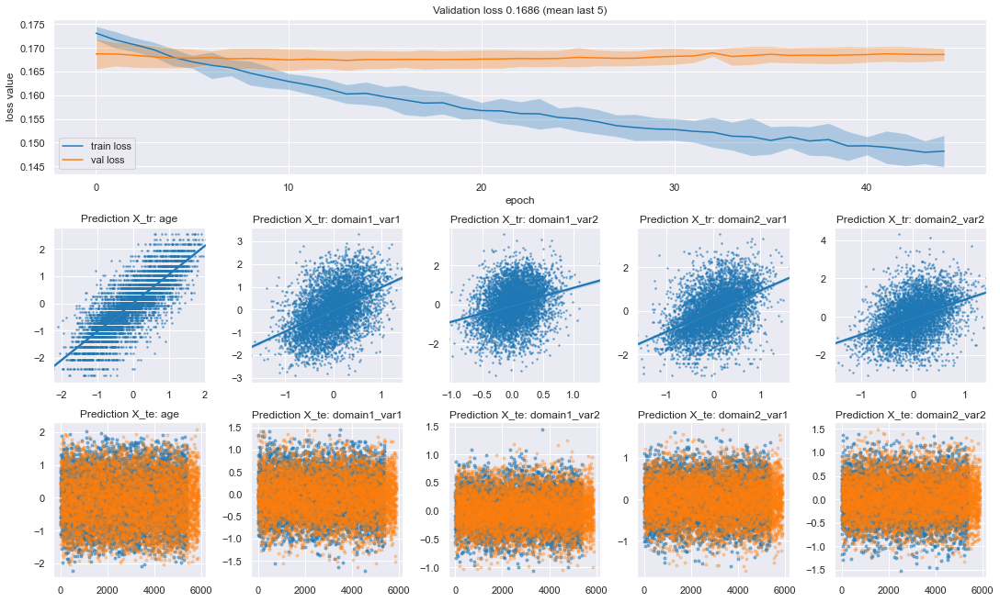

0.148592 0.168636 0.020044000000000006
0042/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


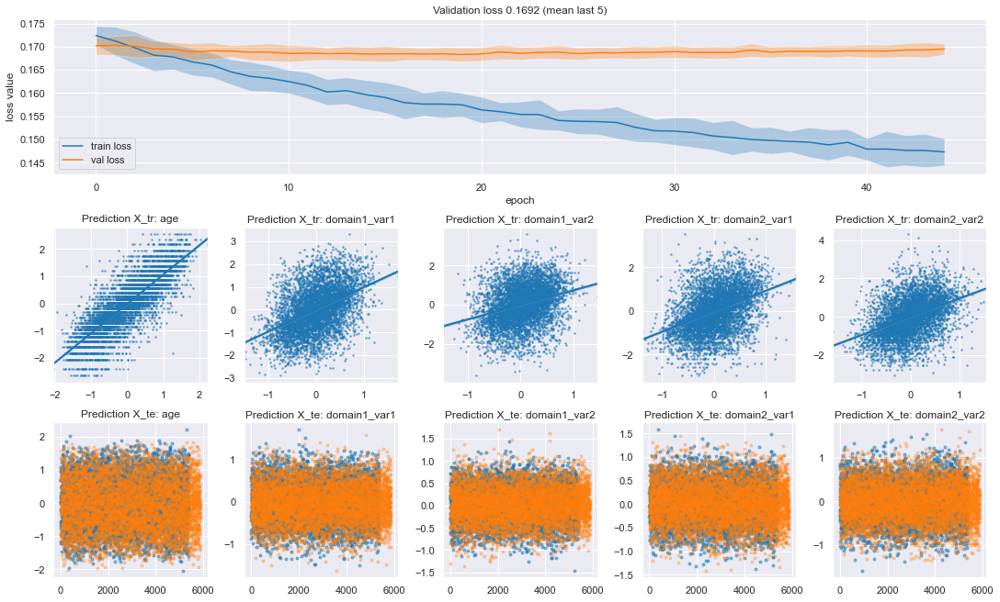

0.147675 0.169236 0.021560999999999997
0043/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


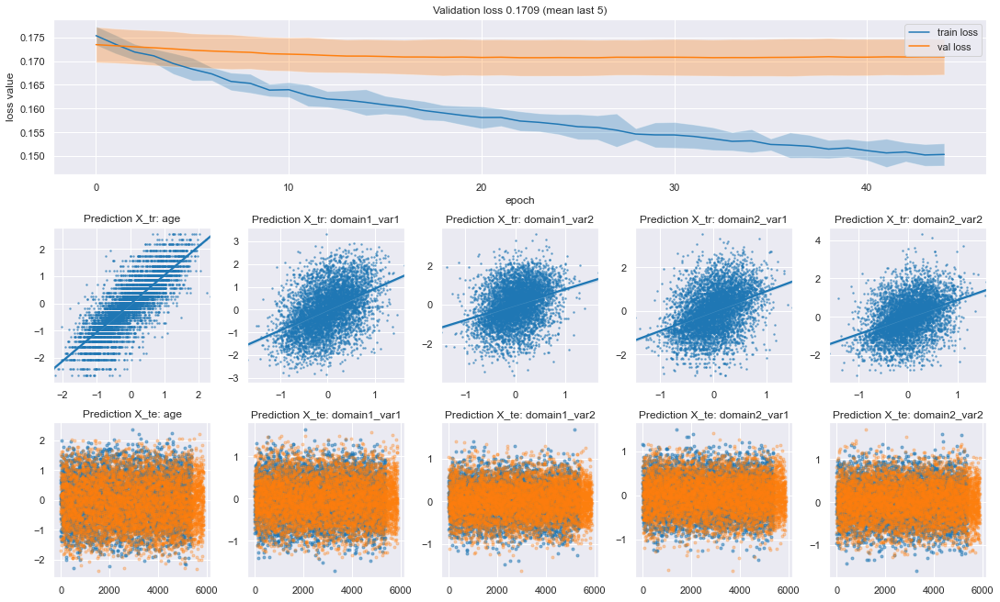

0.150628 0.170898 0.020269999999999982
0044/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


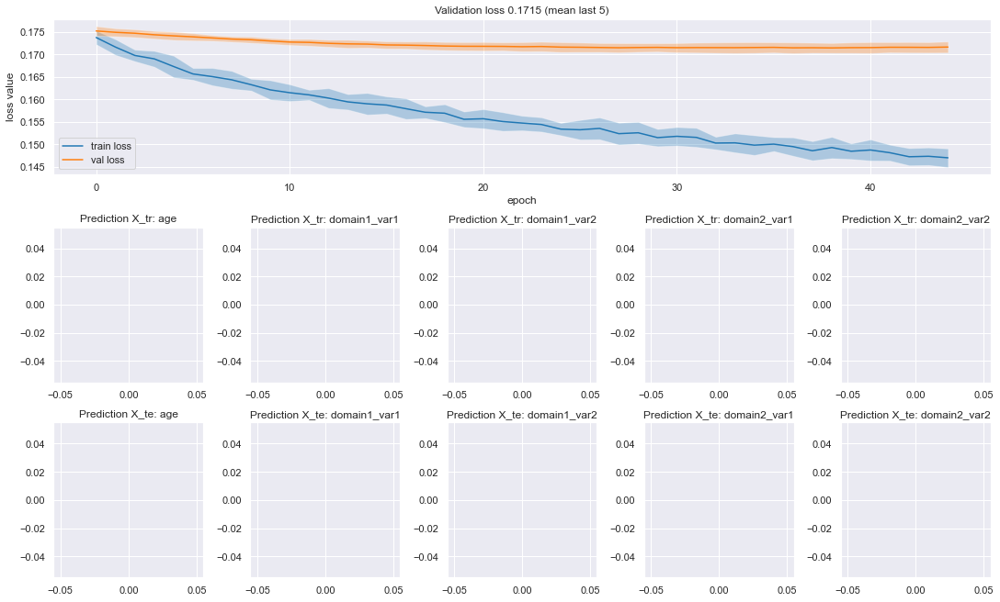

0.147743 0.171536 0.02379299999999998
0045/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


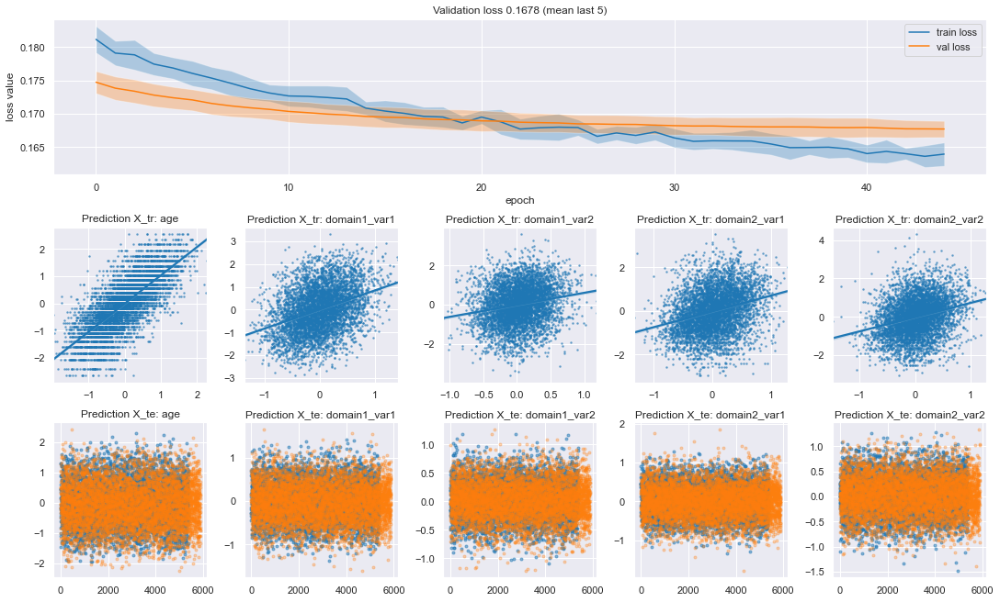

0.164007 0.167803 0.0037960000000000216
0046/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


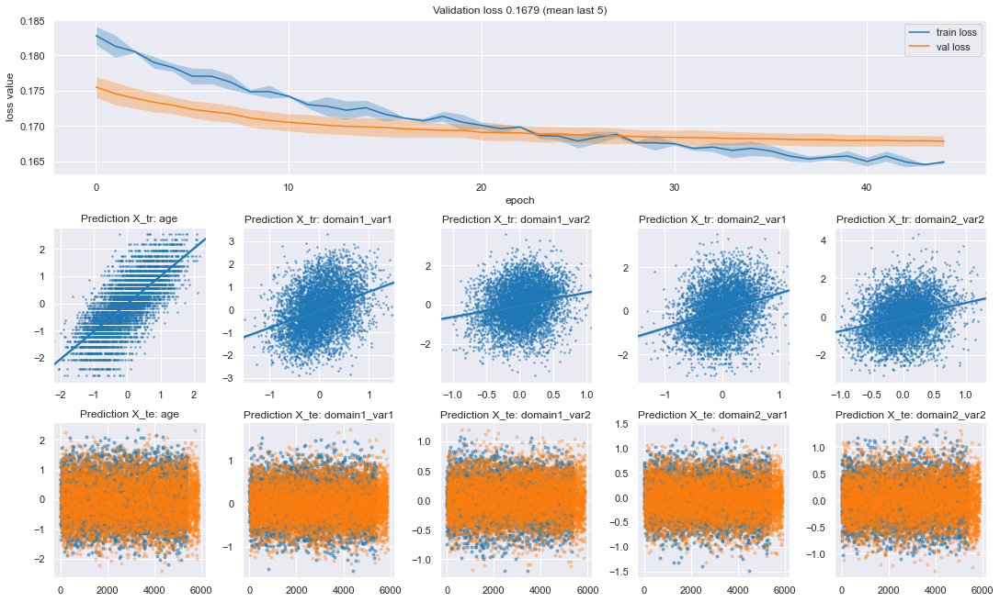

0.16499 0.167897 0.002906999999999993
0047/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 848, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


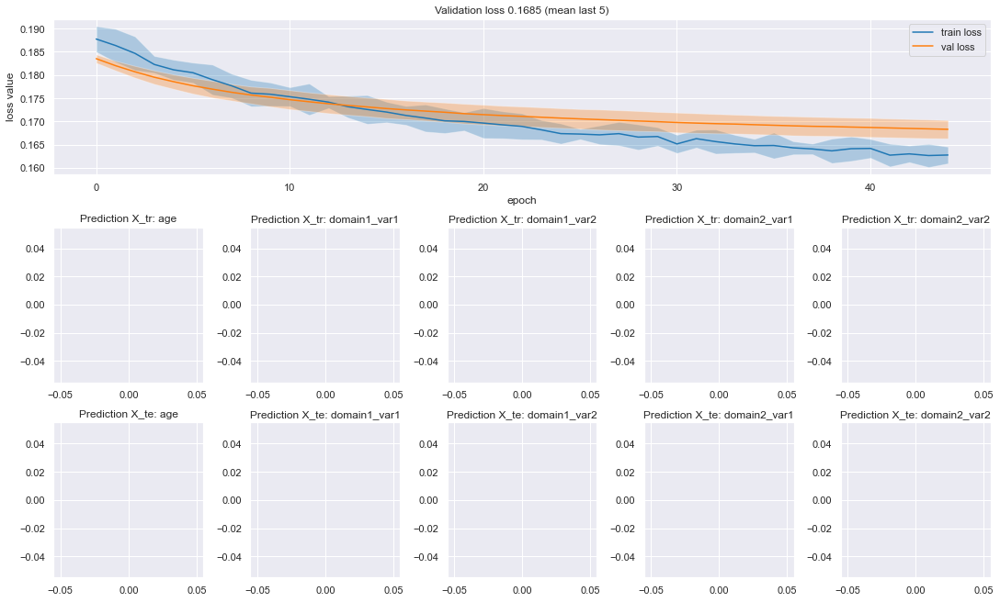

0.163093 0.168519 0.005426000000000014
0048/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 864, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


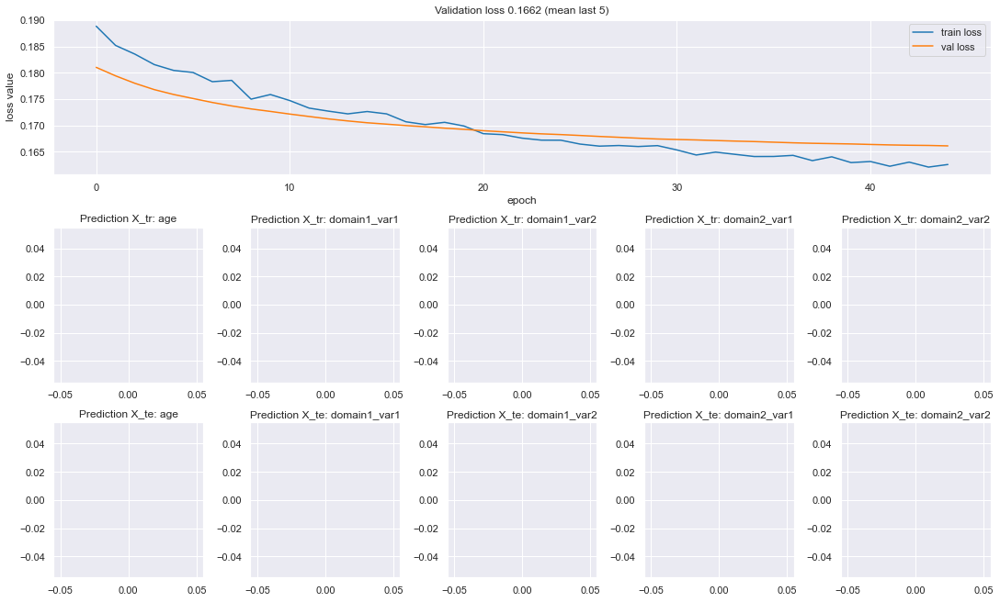

0.162586 0.16622 0.0036339999999999983



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__optimizer,nn__use_batch,nn__use_dropout,pca,scaler
26,0.154505,0.163133,64,50,sigmoid,0.2,"(256, 64, 16)",848,uniform,adagrad,True,True,PCA(n_components=0.99),RobustScaler()
31,0.158838,0.163162,64,50,sigmoid,0.2,"(128, 16)",864,uniform,adagrad,True,True,PCA(n_components=0.99),PowerTransformer()
29,0.161298,0.163725,64,50,sigmoid,0.2,"(128, 16)",1404,uniform,adagrad,True,True,None,PowerTransformer()
30,0.159487,0.163901,64,50,sigmoid,0.2,"(128, 16)",848,uniform,adagrad,True,True,PCA(n_components=0.99),RobustScaler()
34,0.167922,0.164033,64,50,sigmoid,0.2,"(32,)",848,uniform,adagrad,True,True,PCA(n_components=0.99),RobustScaler()
35,0.168158,0.164227,64,50,sigmoid,0.2,"(32,)",864,uniform,adagrad,True,True,PCA(n_components=0.99),PowerTransformer()
24,0.156636,0.164259,64,50,sigmoid,0.2,"(256, 64, 16)",1404,uniform,adagrad,True,True,None,RobustScaler()
32,0.167376,0.164361,64,50,sigmoid,0.2,"(32,)",1404,uniform,adagrad,True,True,None,RobustScaler()
25,0.155301,0.164664,64,50,sigmoid,0.2,"(256, 64, 16)",1404,uniform,adagrad,True,True,None,PowerTransformer()
33,0.167342,0.164943,64,50,sigmoid,0.2,"(32,)",1404,uniform,adagrad,True,True,None,PowerTransformer()


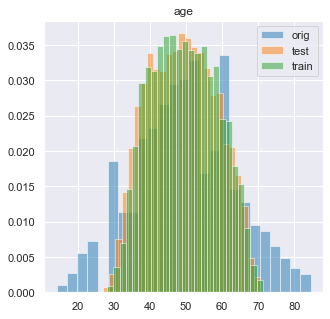

/anaconda3/envs/neuro/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/anaconda3/envs/neuro/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


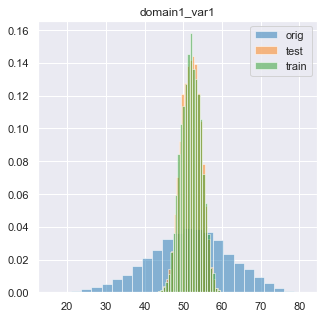

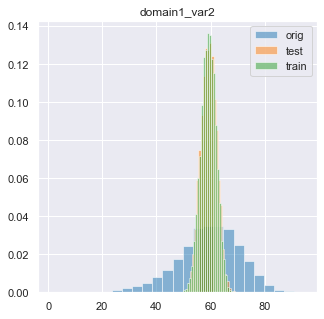

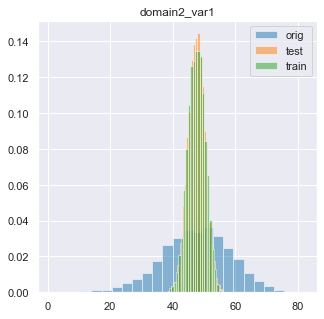

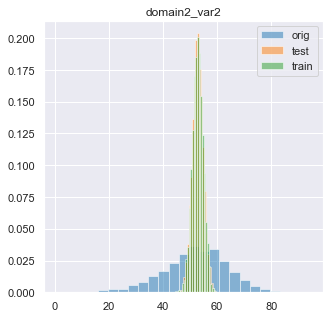

Best score for merge at 0.163133 
Starting with dataset short_merge
Removing 440 missing values from target dataset.
Size of dataset:  (5385, 1654)
48 grid points will be checked!

---Start_Grid_Exploration---



0001/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


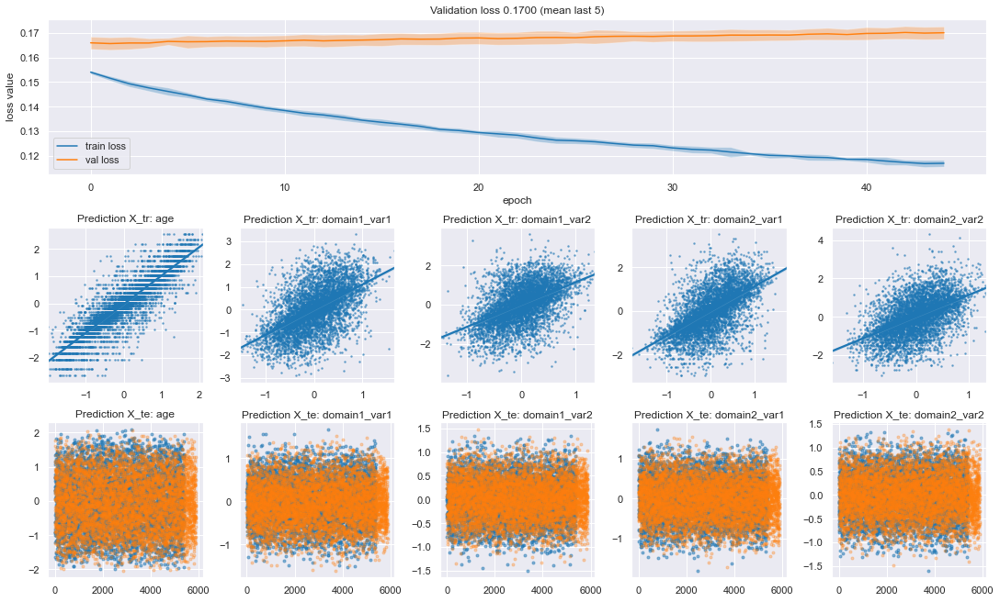

0.117457 0.170016 0.052558999999999995
0002/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


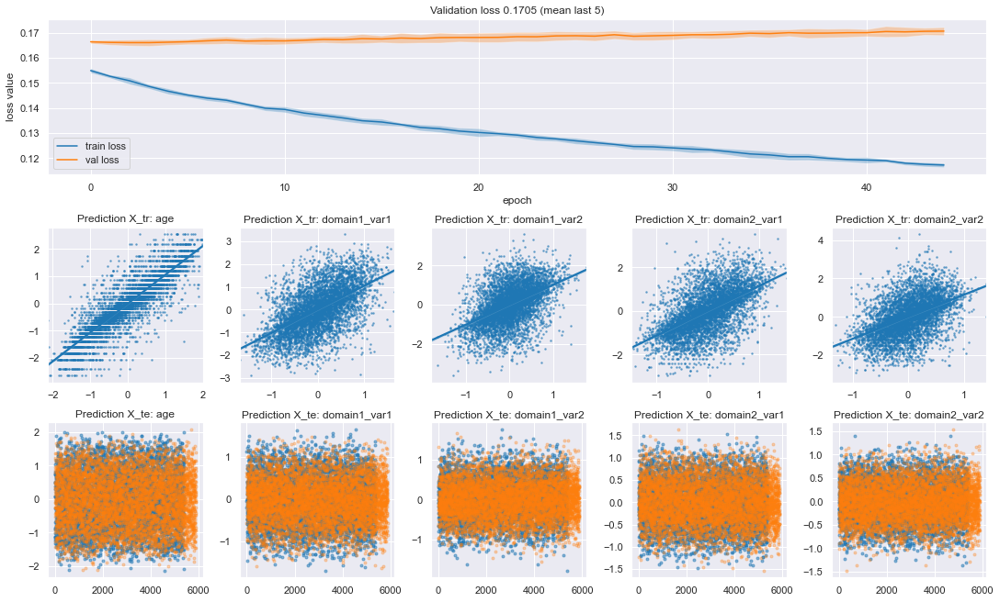

0.118211 0.170451 0.052239999999999995
0003/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


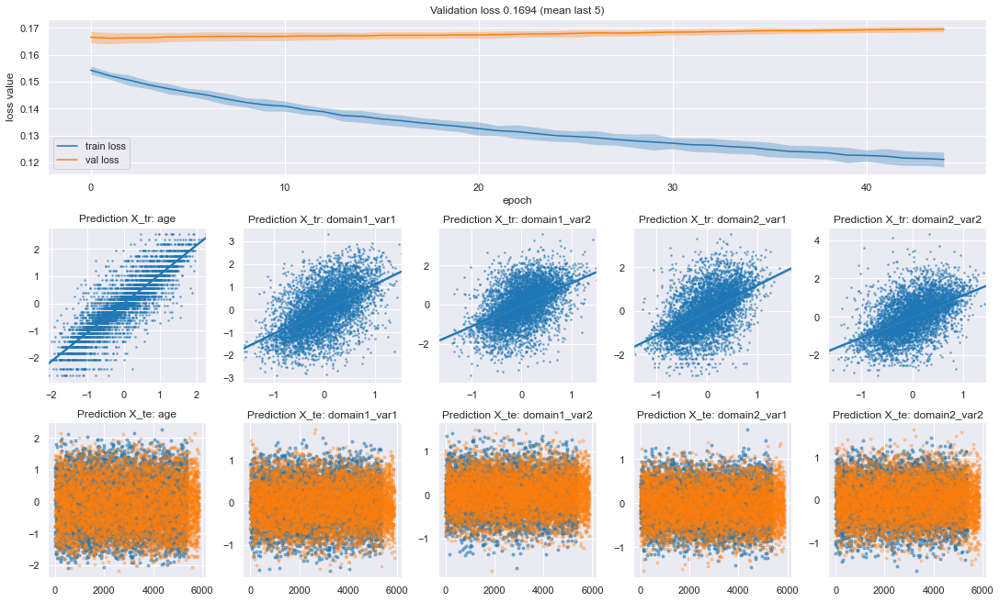

0.121773 0.169407 0.047633999999999996
0004/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


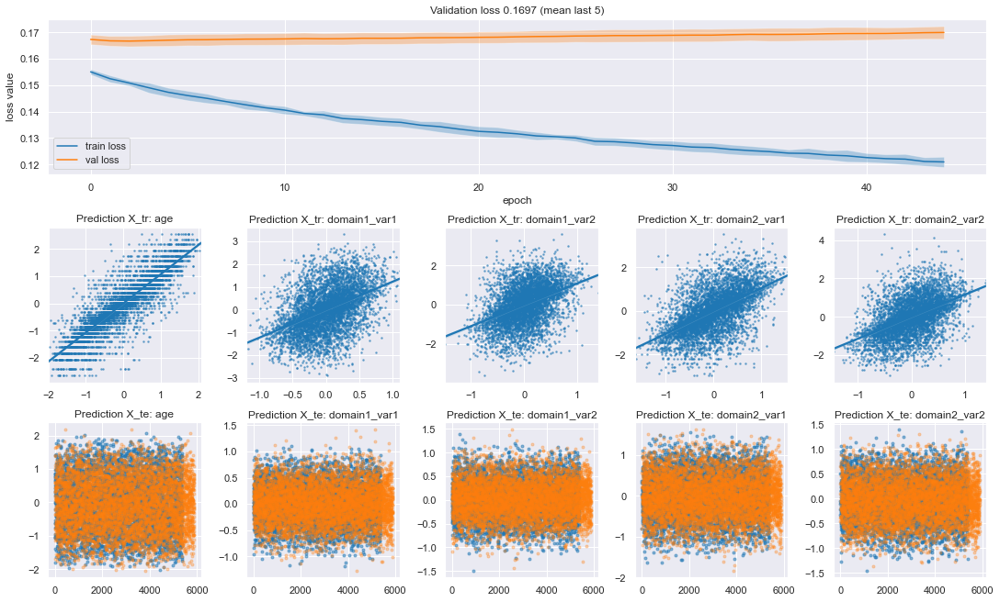

0.121774 0.169726 0.047951999999999995
0005/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


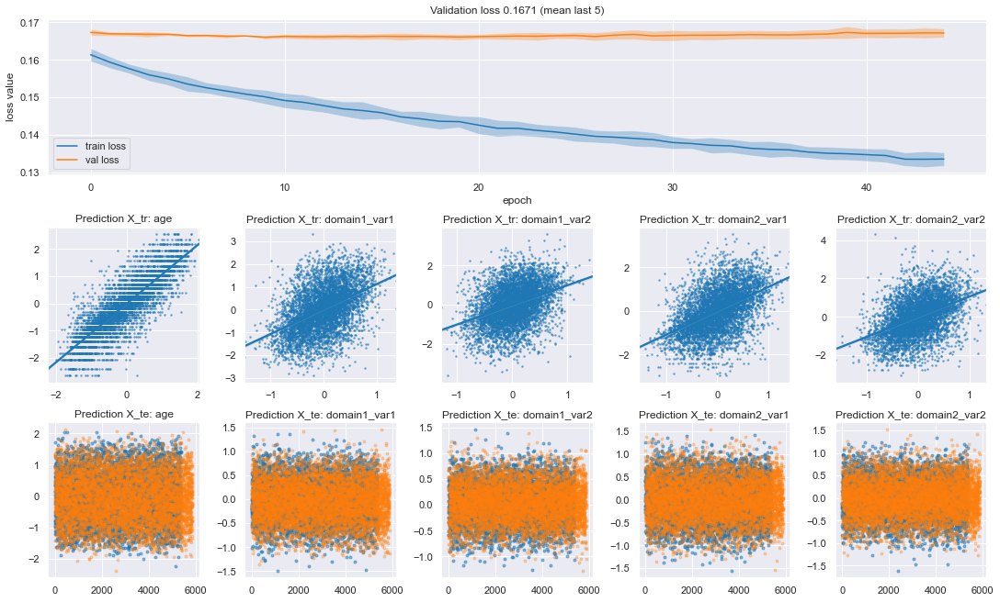

0.133897 0.16713 0.03323300000000001
0006/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


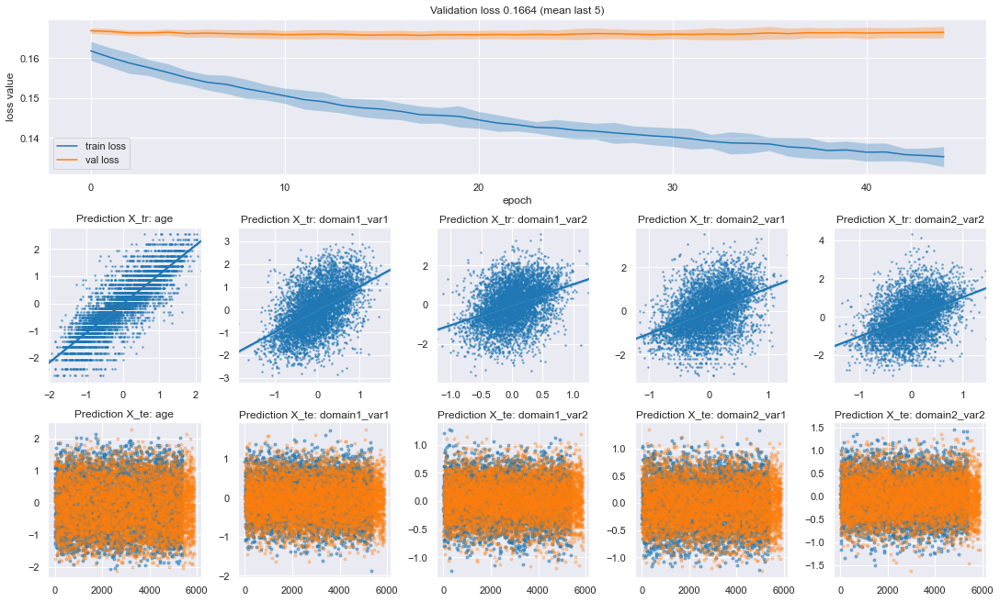

0.135902 0.166367 0.030464999999999992
0007/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


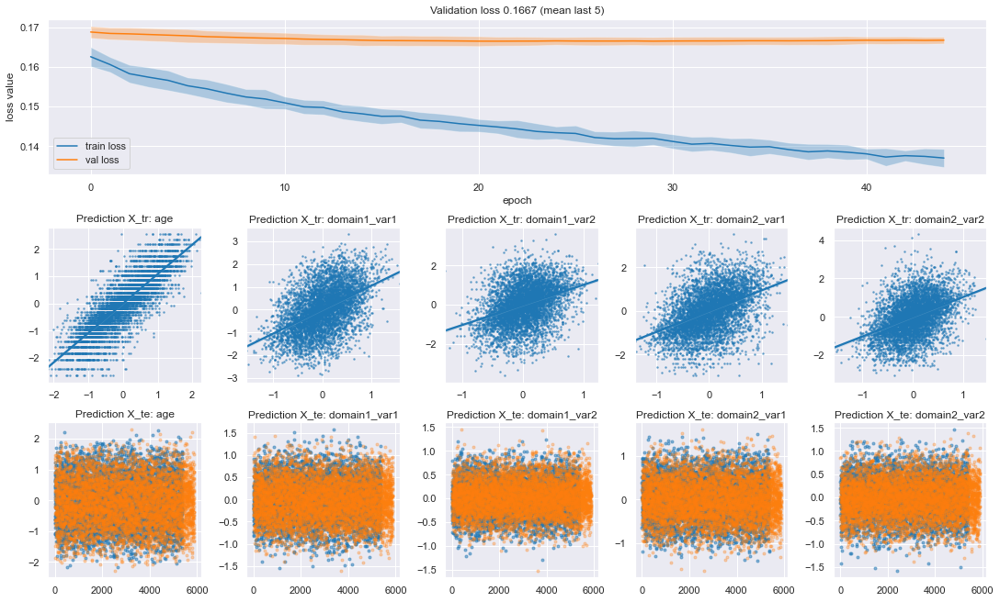

0.137472 0.166691 0.029218999999999995
0008/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


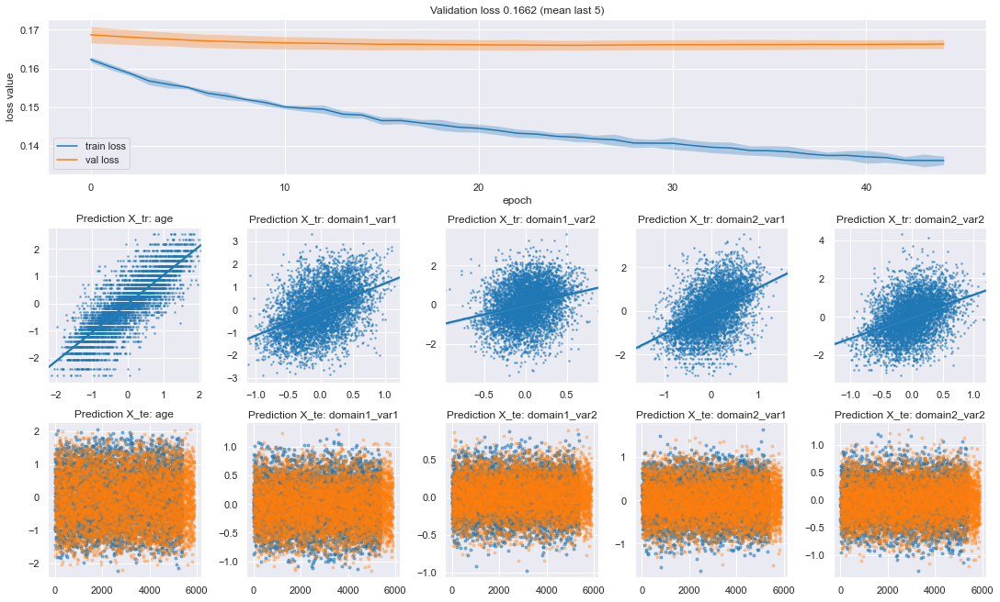

0.136575 0.166233 0.02965799999999999
0009/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


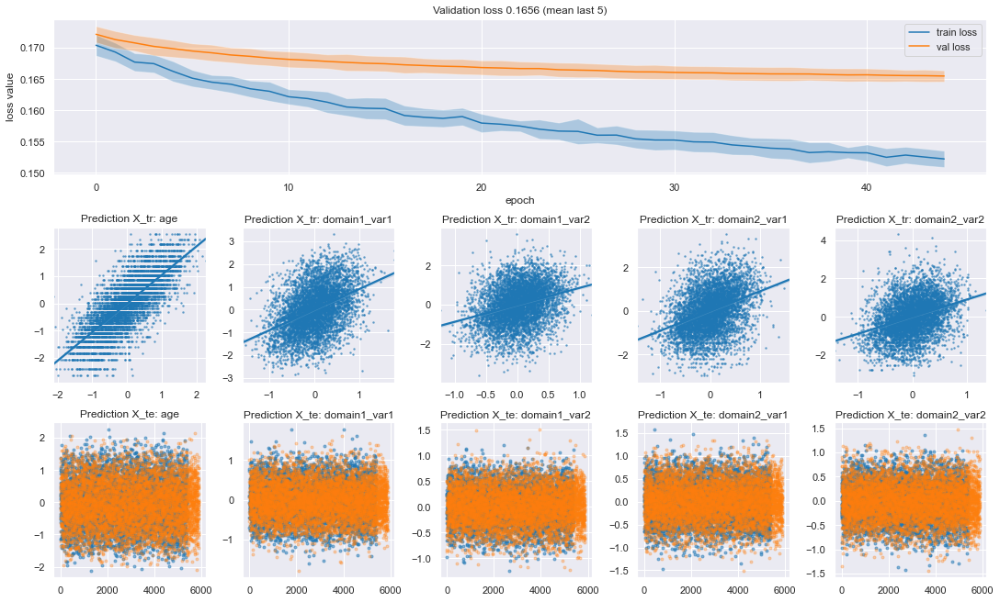

0.152675 0.165572 0.012896999999999992
0010/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


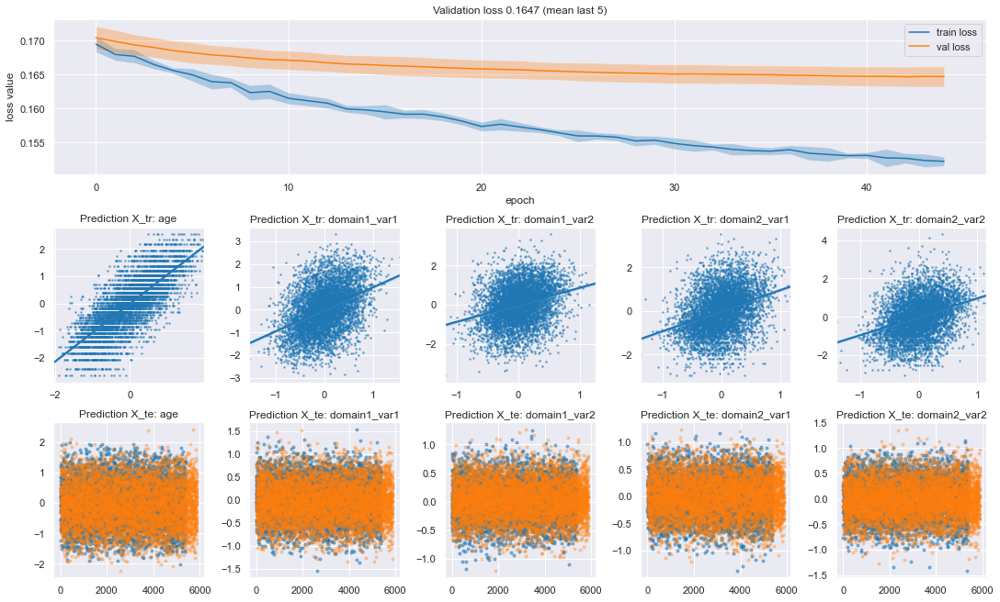

0.152589 0.164716 0.012126999999999999
0011/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


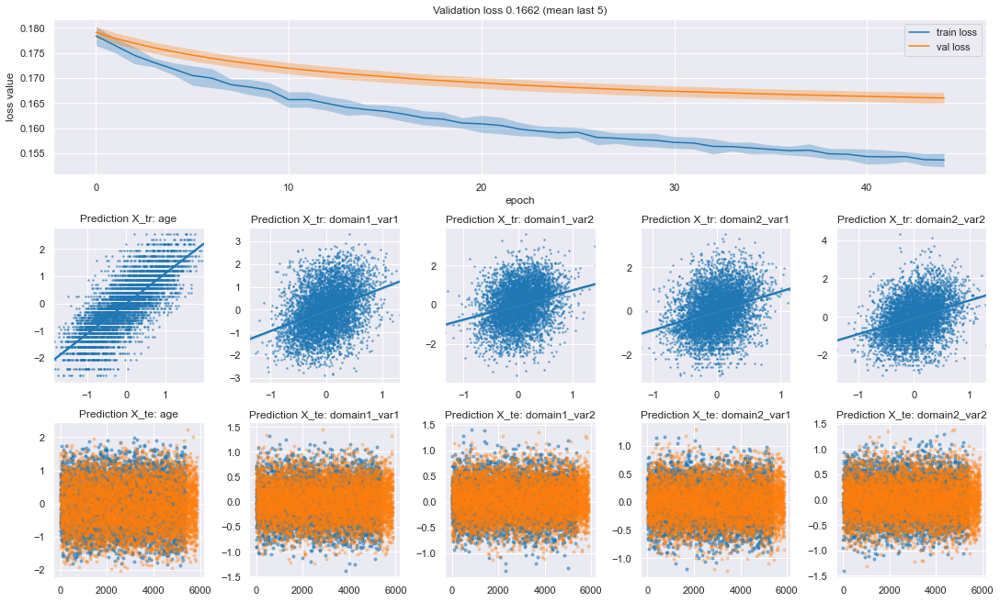

0.154067 0.166182 0.012114999999999987
0012/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'softsign', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


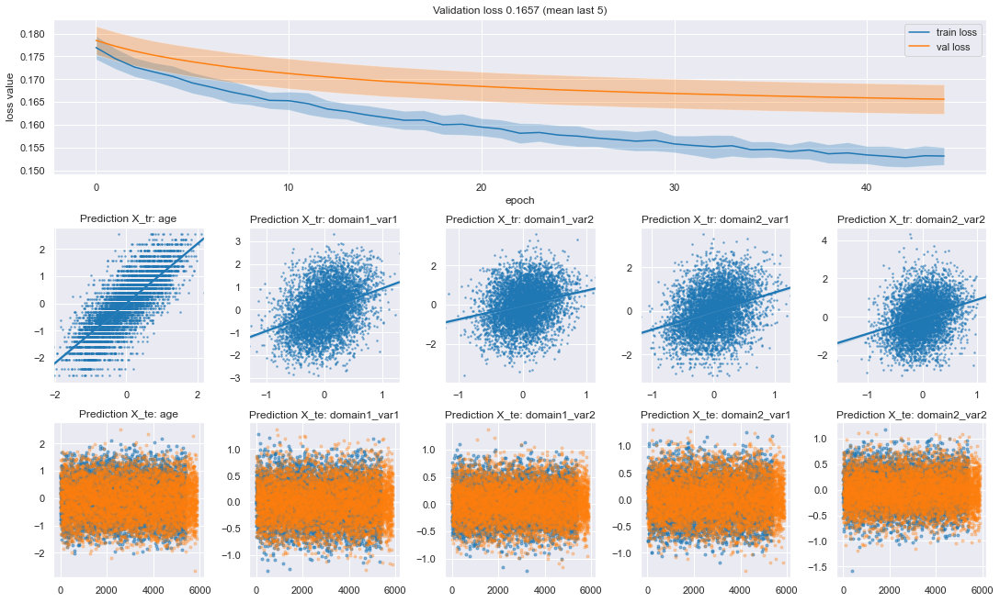

0.15311 0.165737 0.012627
0013/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


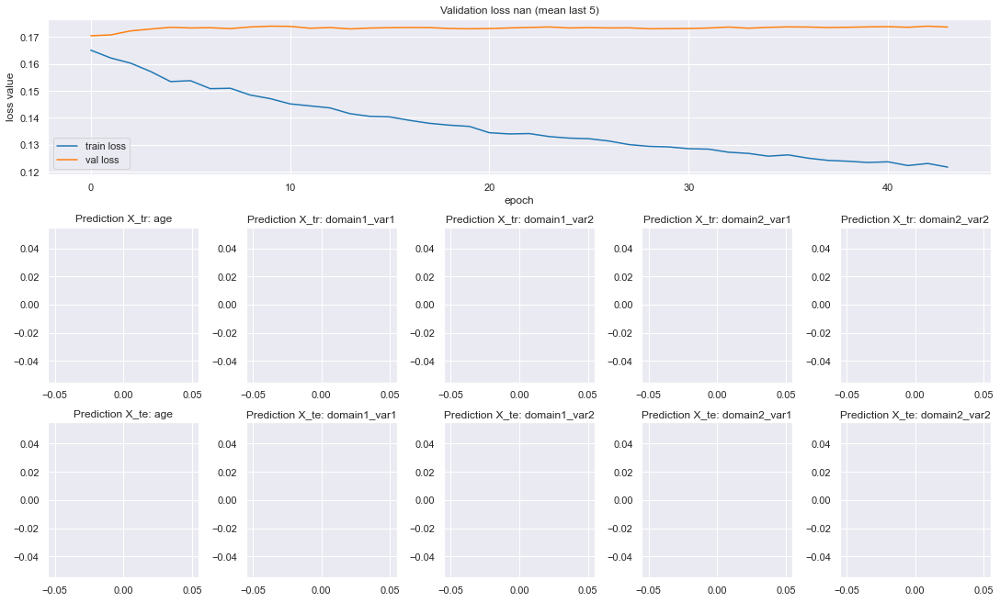

nan nan nan
0014/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


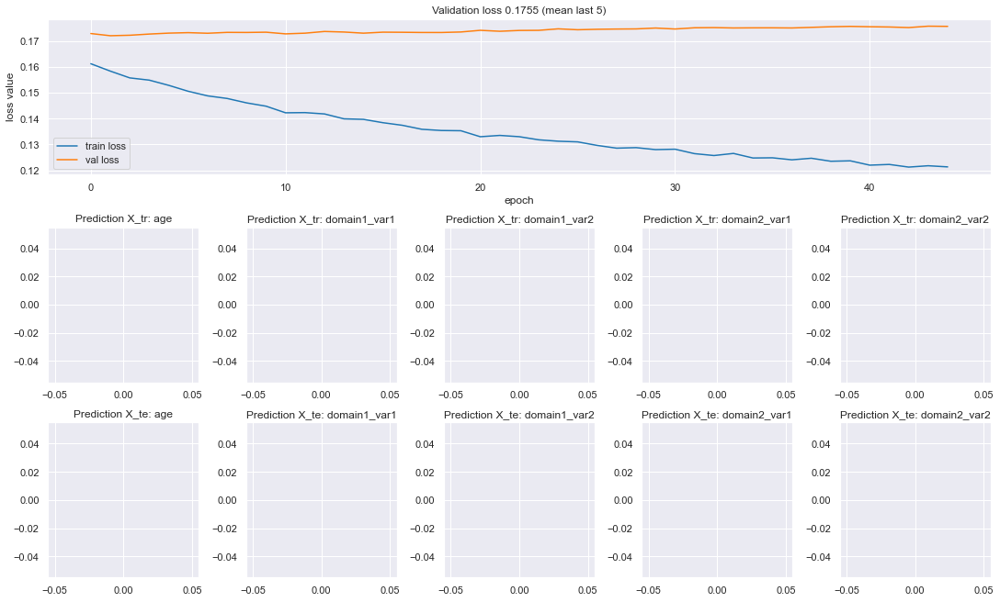

0.121724 0.175468 0.053744000000000014
0015/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


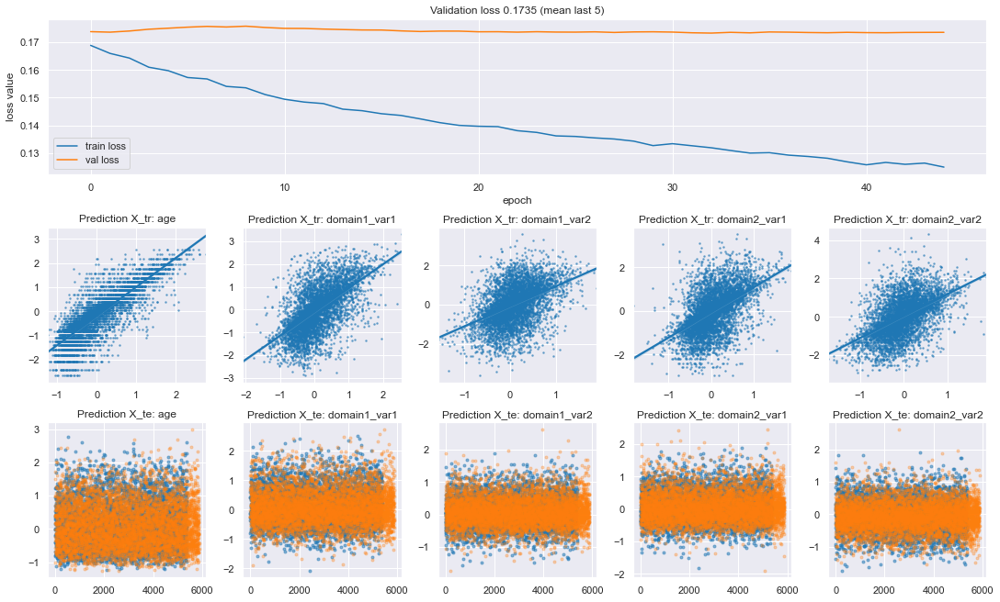

0.125994 0.173465 0.04747100000000001
0016/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


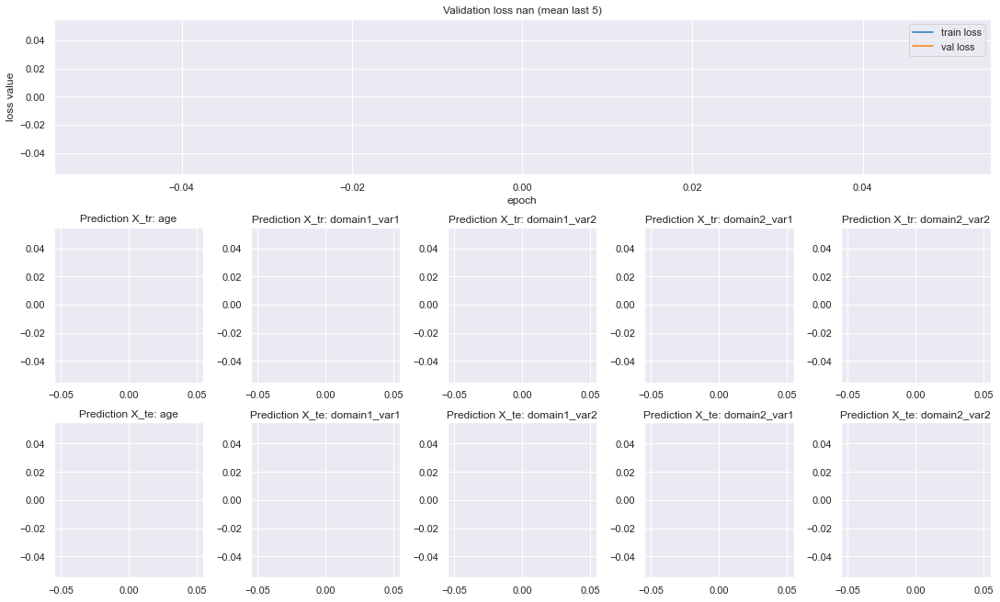

nan nan nan
0017/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


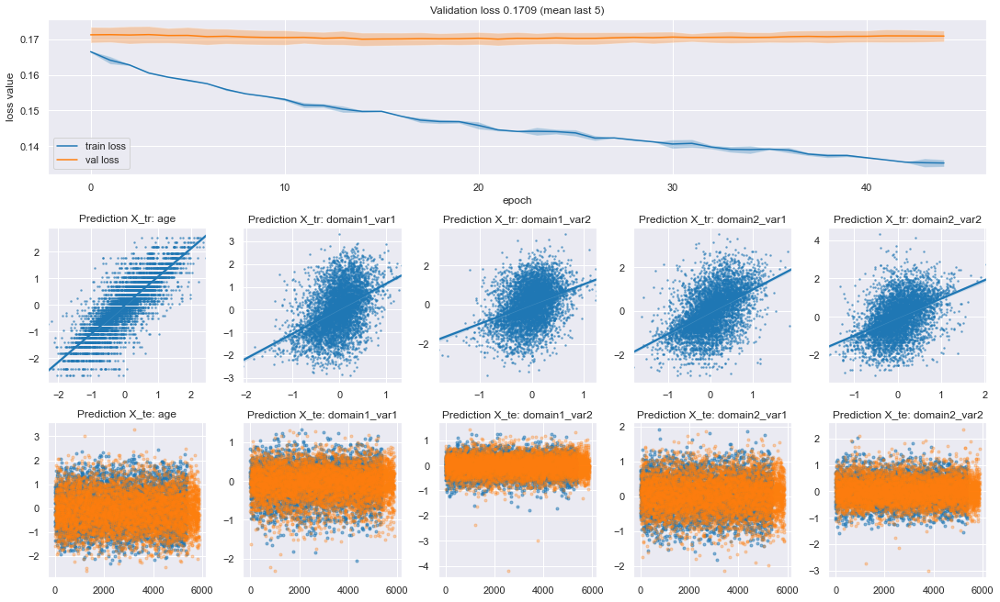

0.135828 0.17087 0.03504199999999999
0018/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


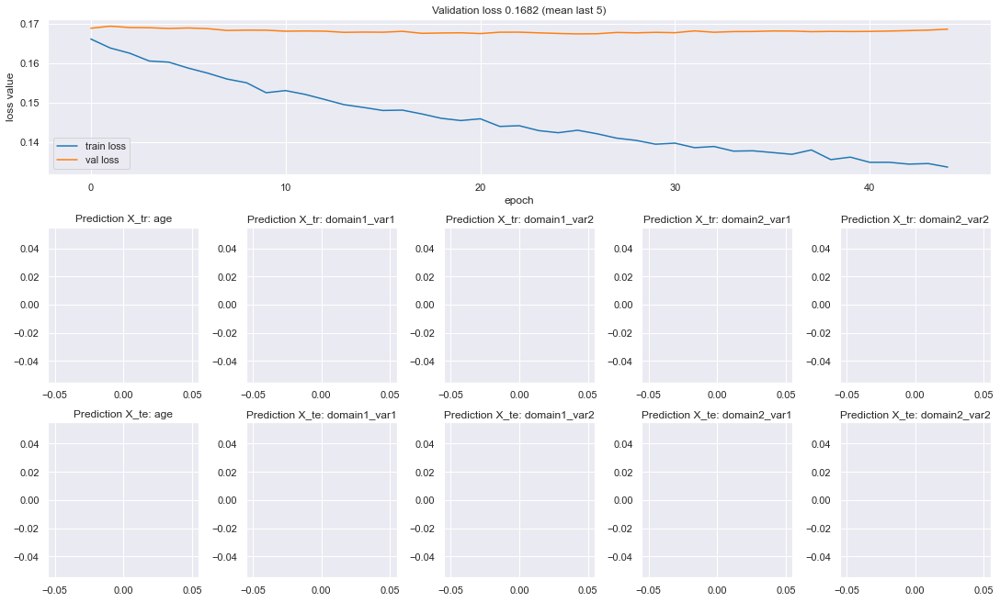

0.134497 0.16822 0.033723
0019/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


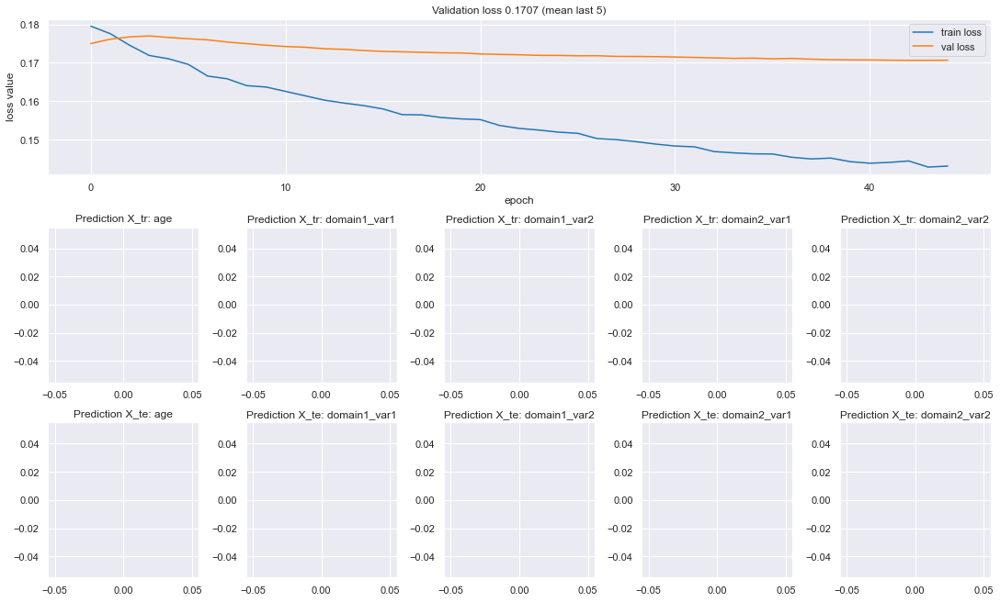

0.143705 0.170692 0.02698700000000001
0020/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


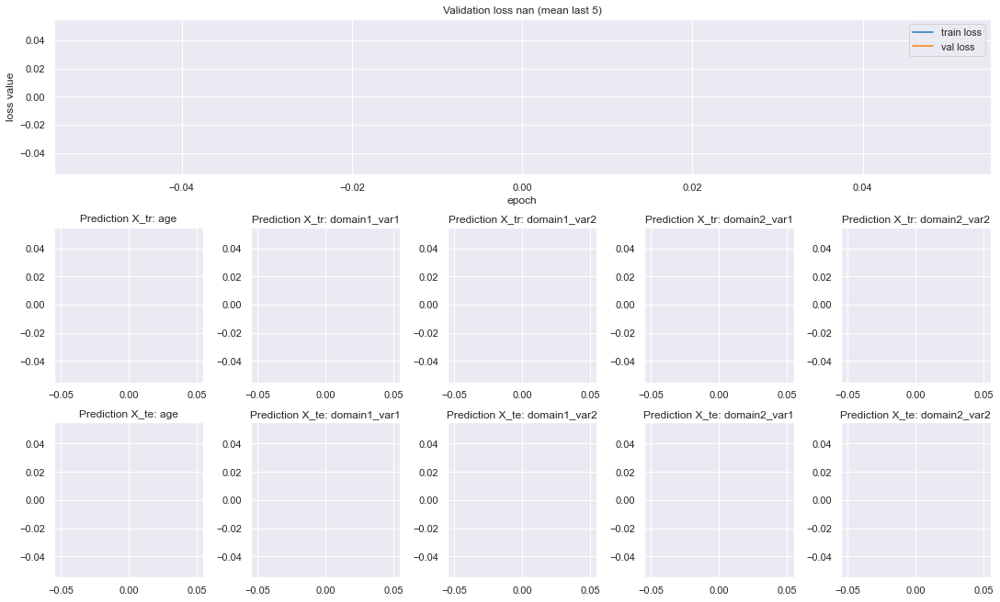

nan nan nan
0021/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


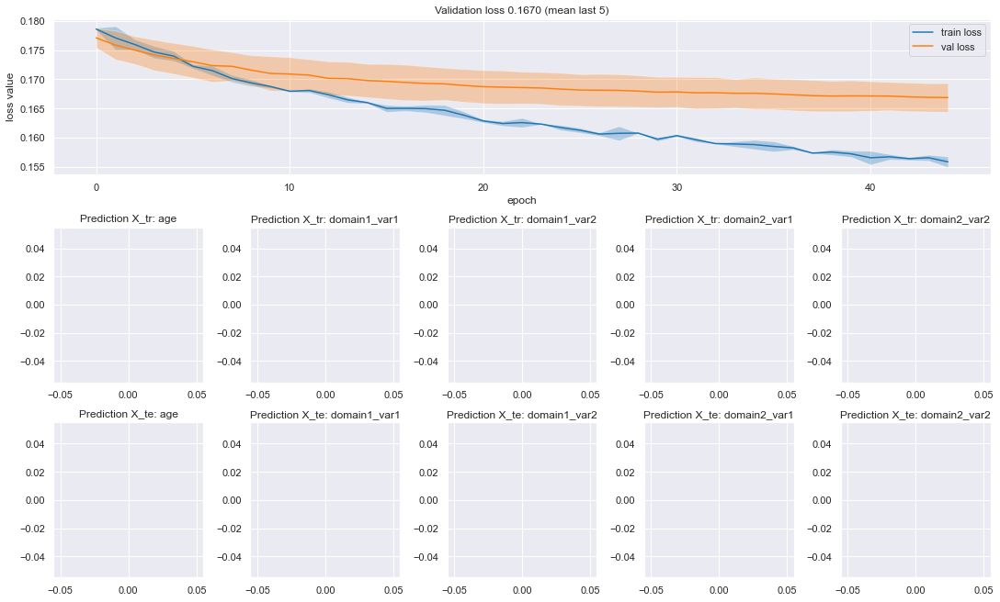

0.156406 0.166999 0.010593000000000019
0022/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


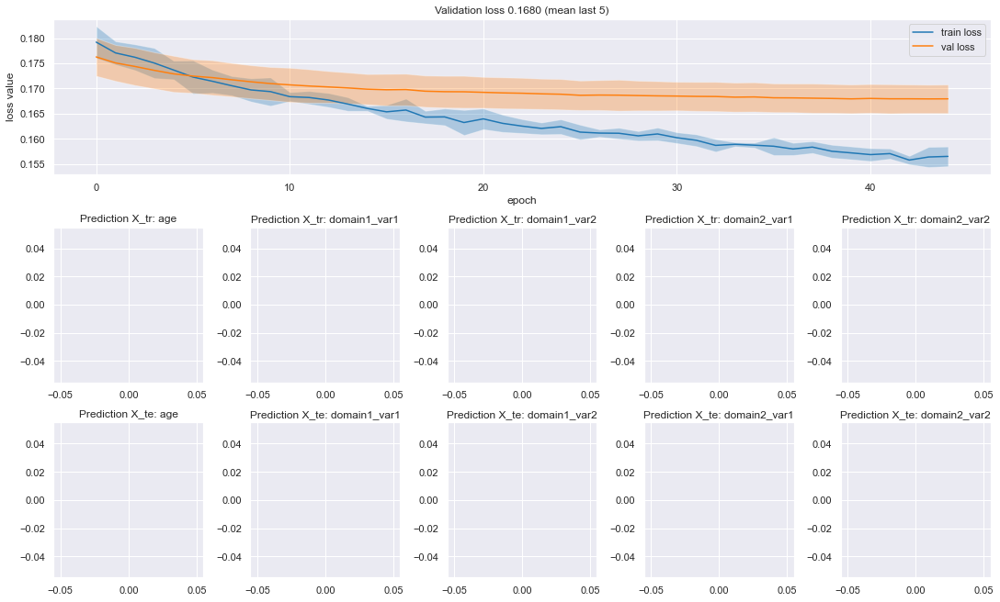

0.156529 0.167961 0.011431999999999998
0023/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


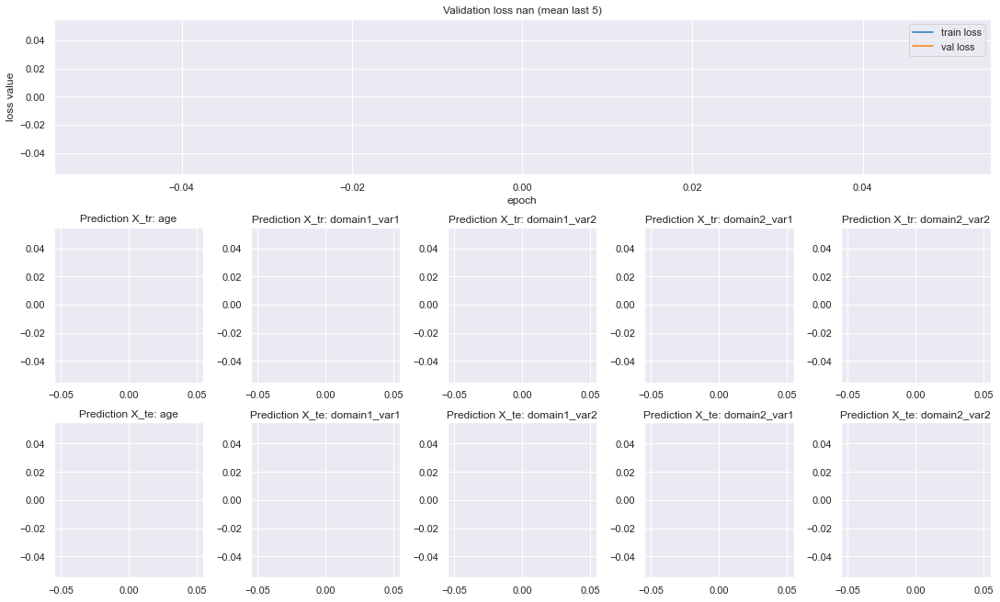

nan nan nan
0024/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'swish', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


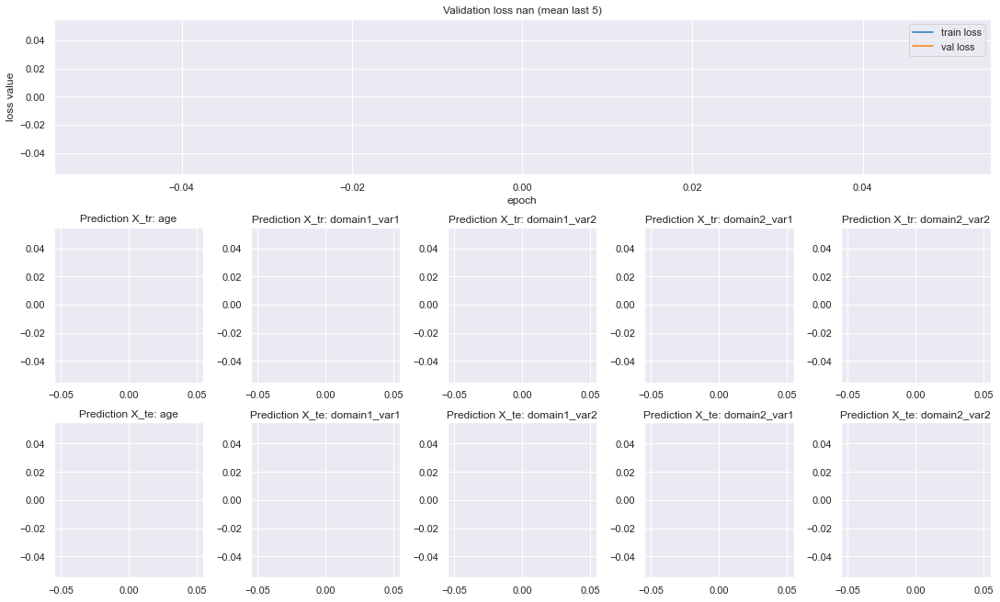

nan nan nan
0025/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


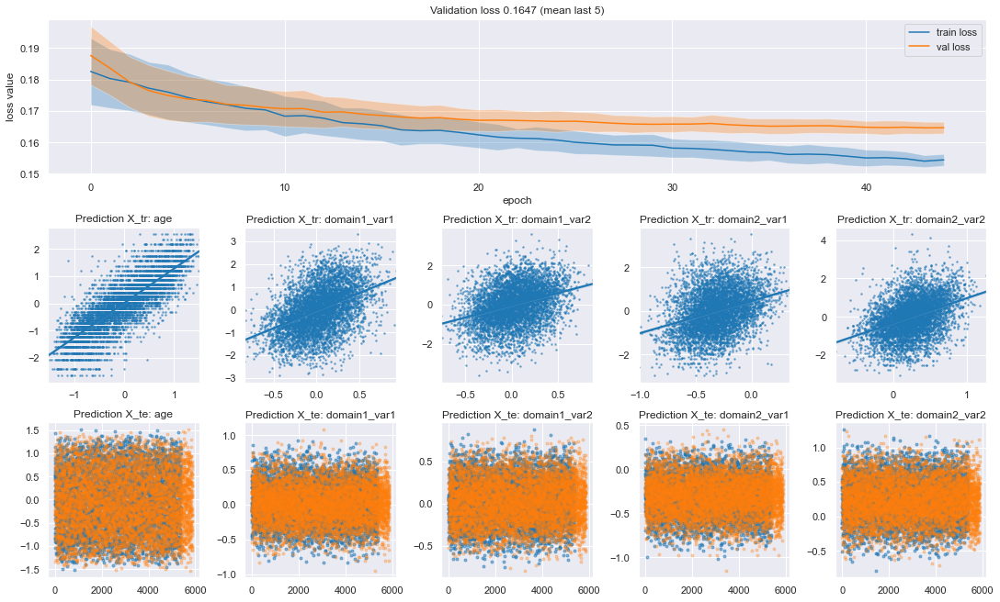

0.154706 0.164723 0.010016999999999998
0026/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


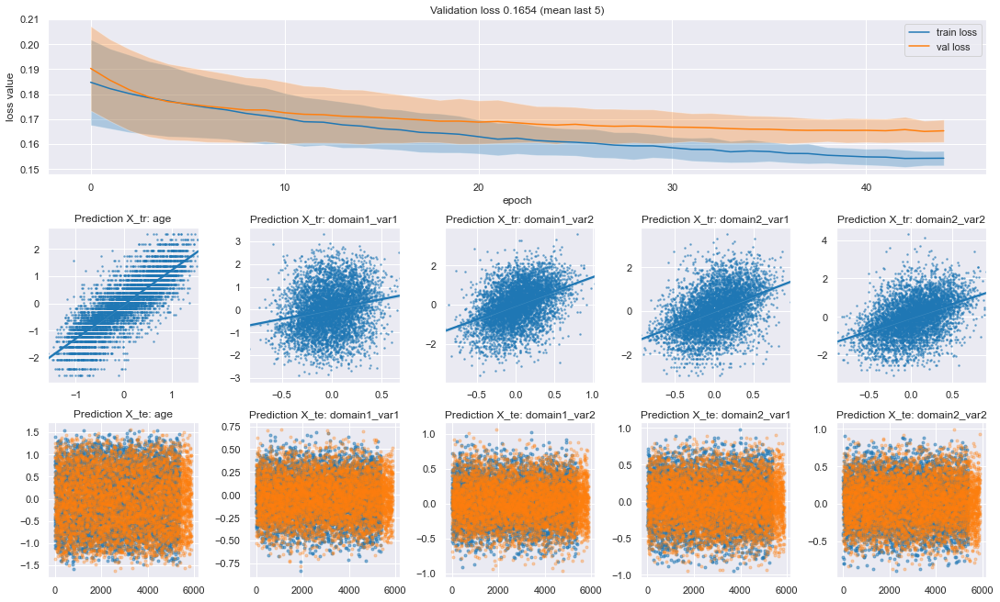

0.154537 0.165438 0.010900999999999994
0027/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


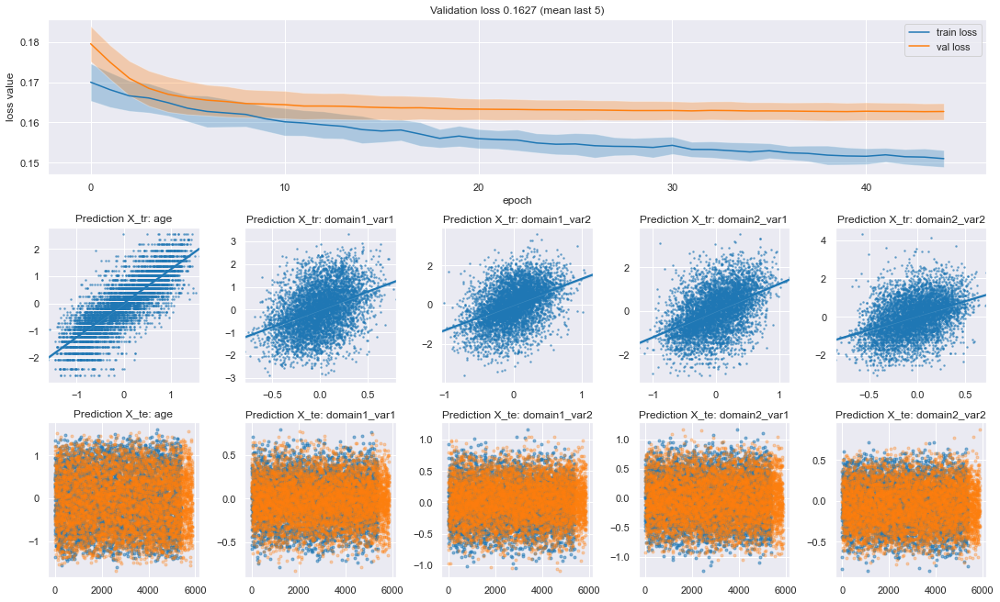

0.151517 0.162735 0.011217999999999978
0028/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


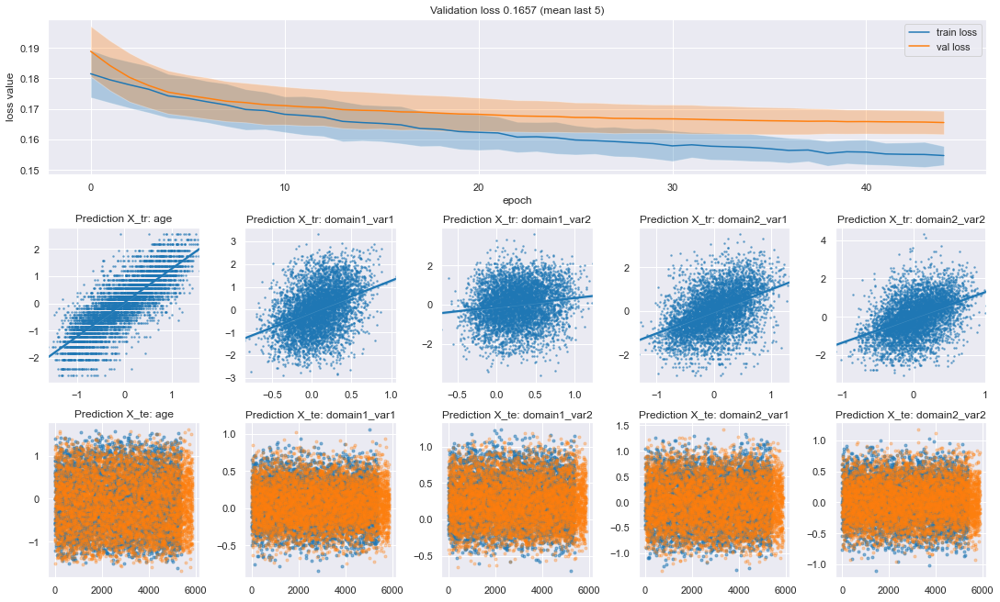

0.155231 0.165741 0.010509999999999992
0029/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


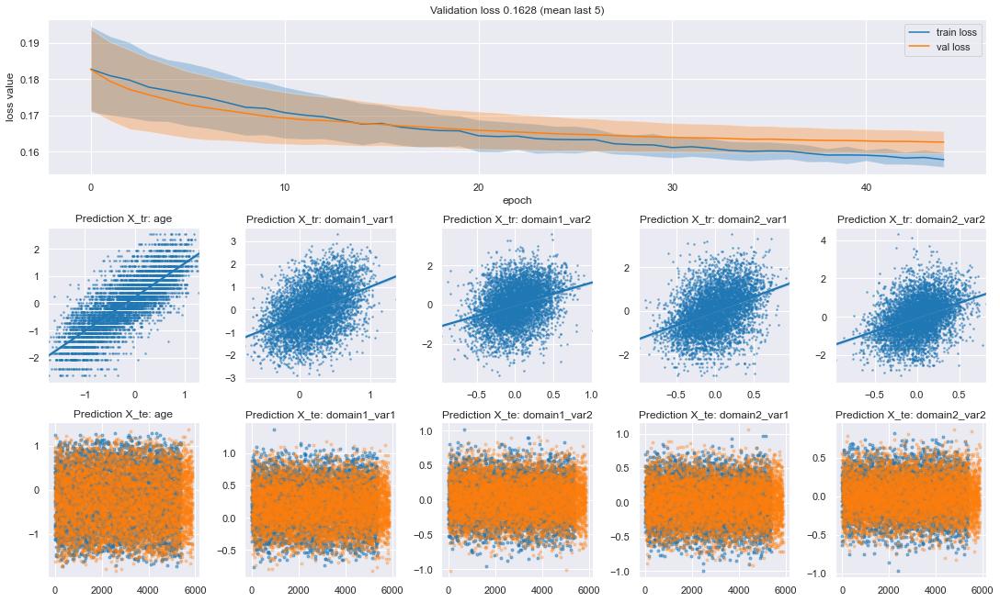

0.15847 0.162824 0.004353999999999997
0030/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


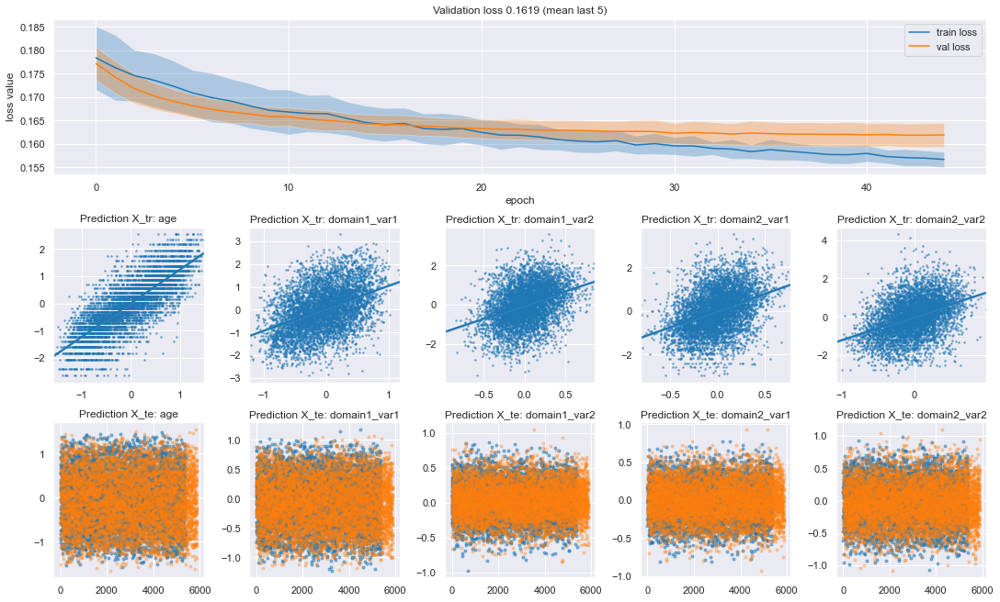

0.157191 0.161917 0.004726000000000008
0031/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


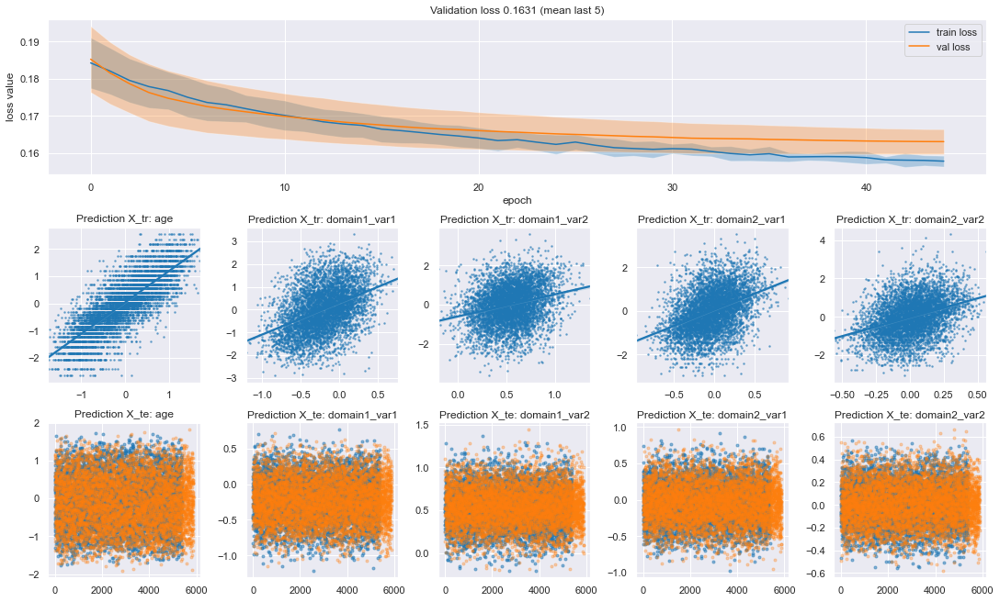

0.158182 0.163146 0.004964000000000024
0032/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


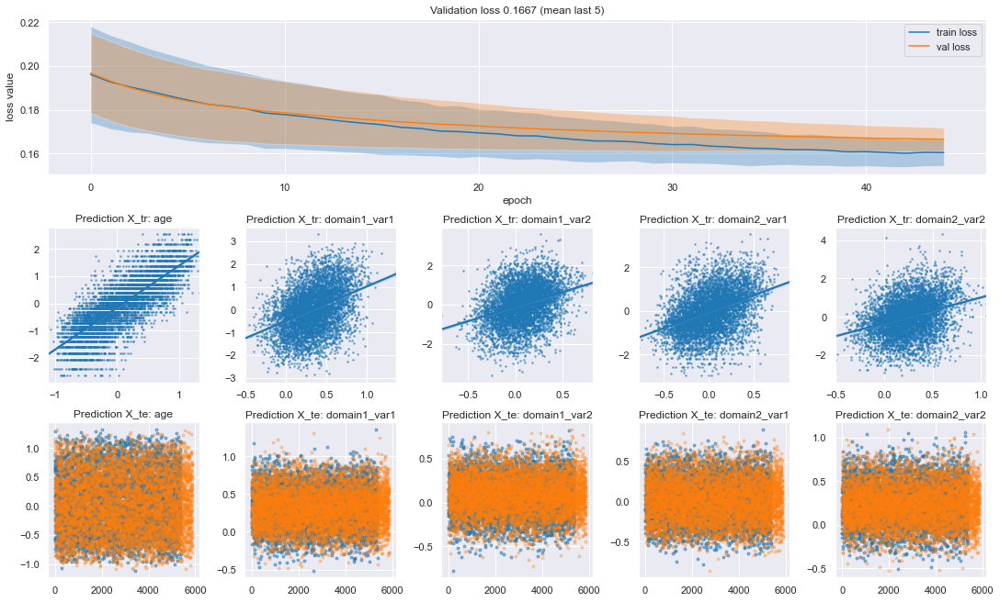

0.160431 0.166728 0.006296999999999997
0033/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


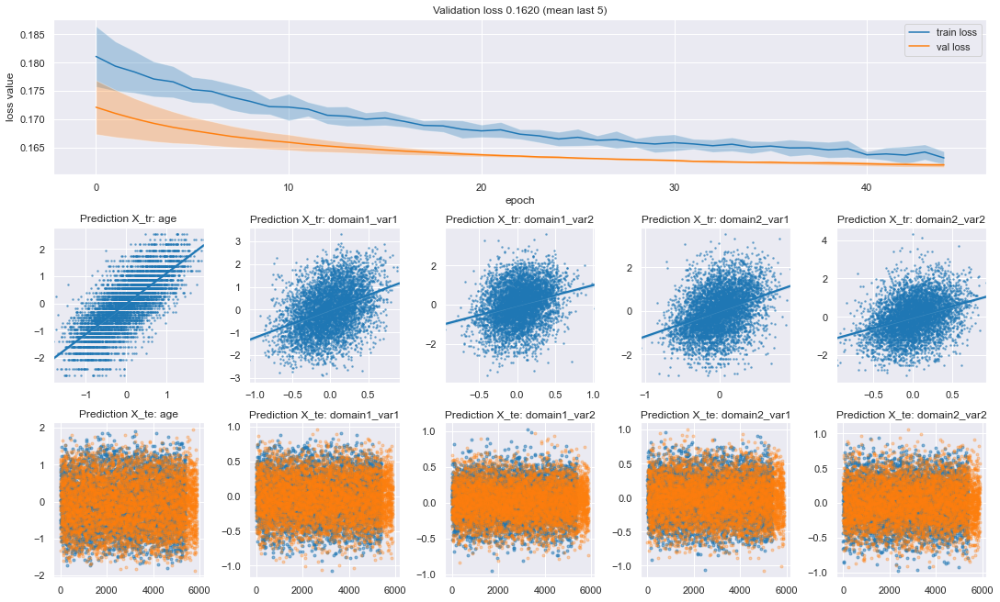

0.163715 0.162002 -0.0017129999999999923
0034/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


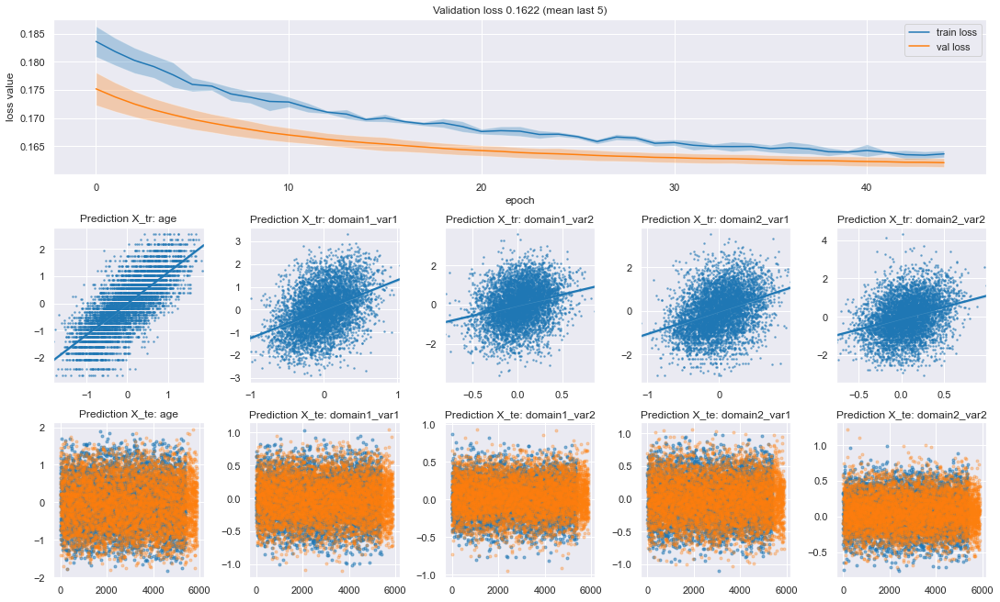

0.163715 0.162153 -0.0015620000000000078
0035/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


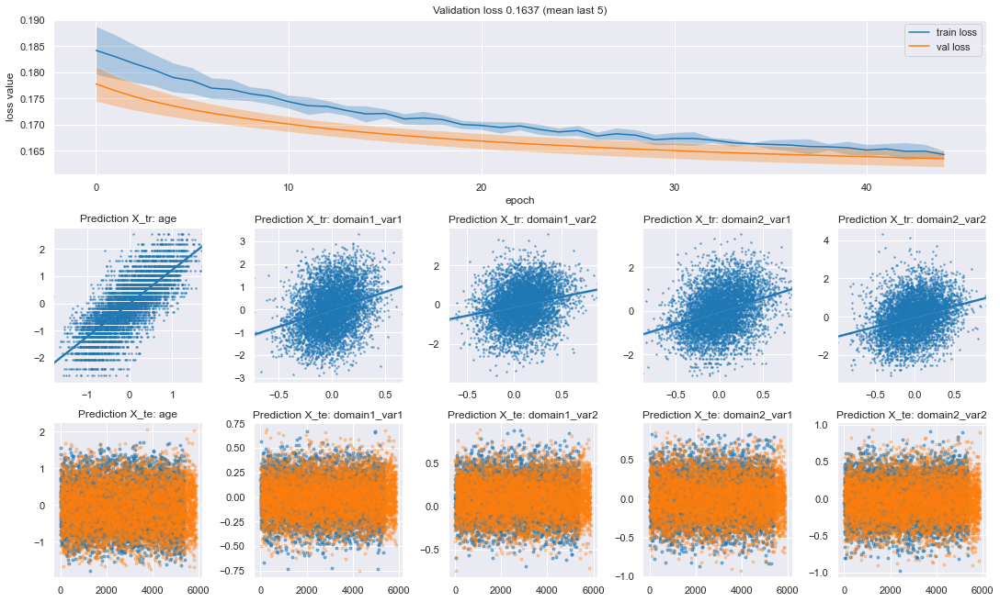

0.164951 0.1637 -0.0012509999999999744
0036/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


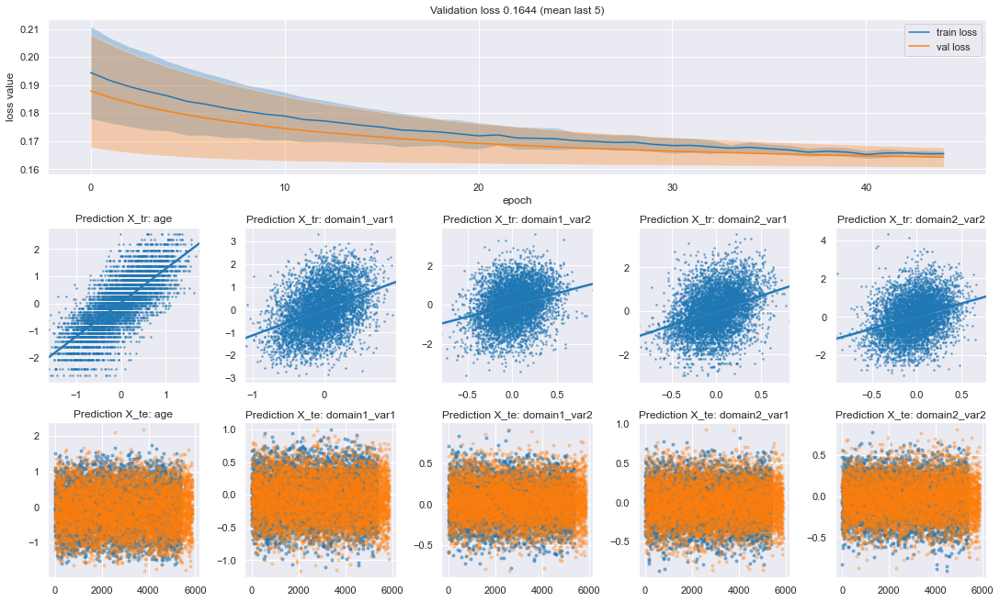

0.165489 0.164421 -0.0010679999999999856
0037/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


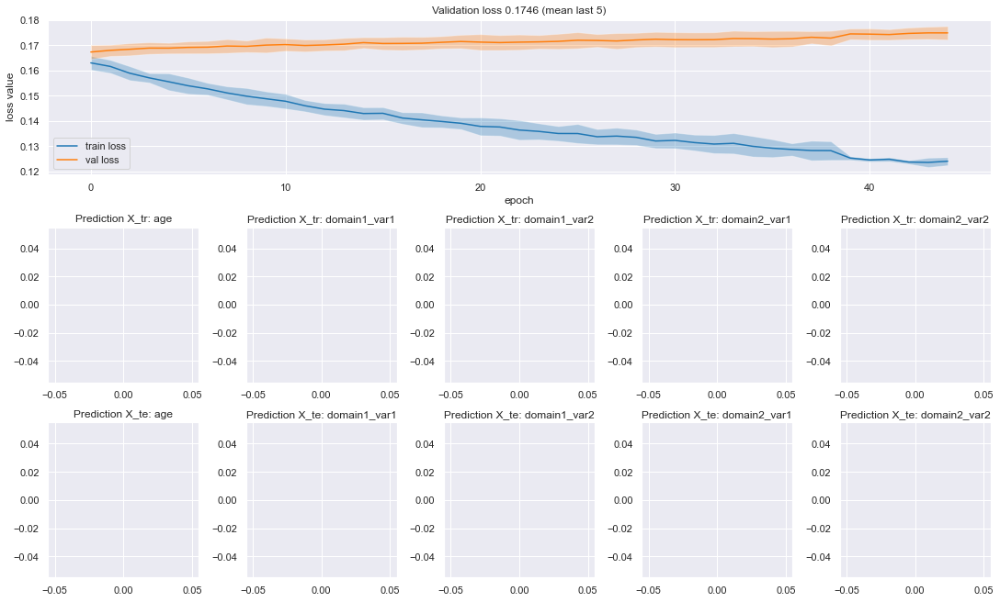

0.124113 0.174609 0.050495999999999985
0038/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


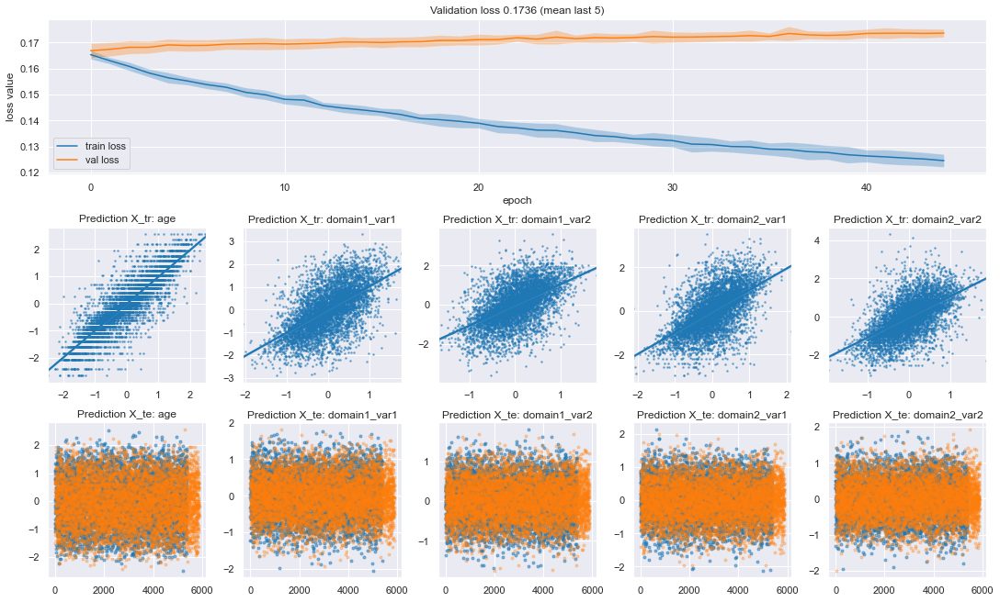

0.125515 0.173623 0.04810800000000001
0039/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


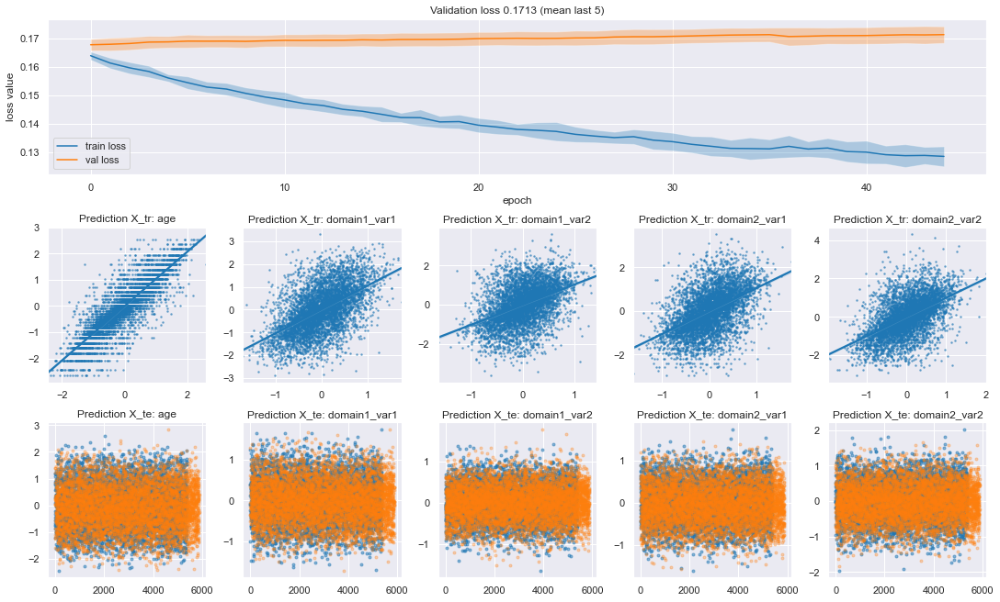

0.12897 0.171263 0.042293
0040/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


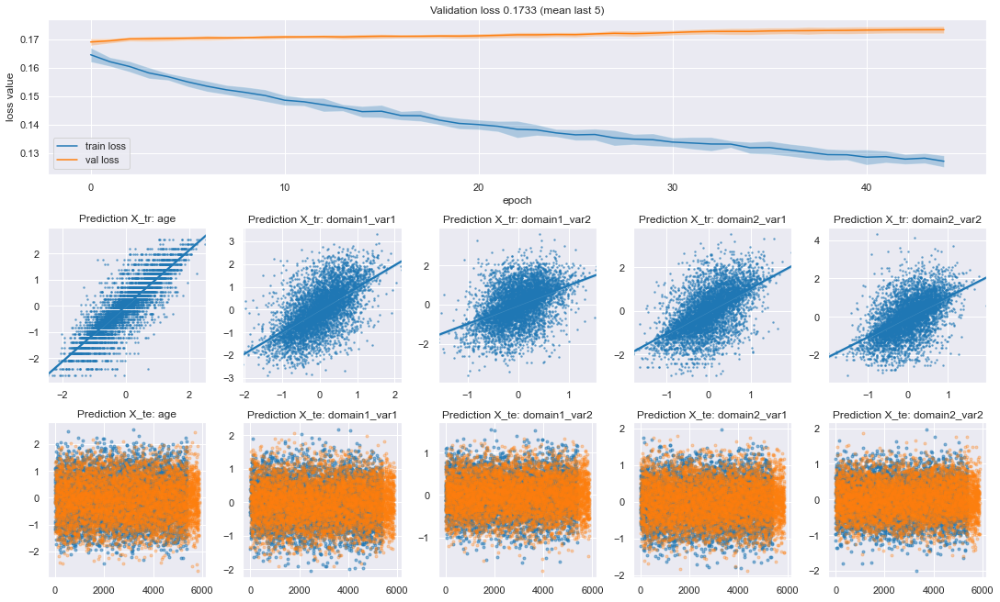

0.128144 0.173274 0.04513
0041/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


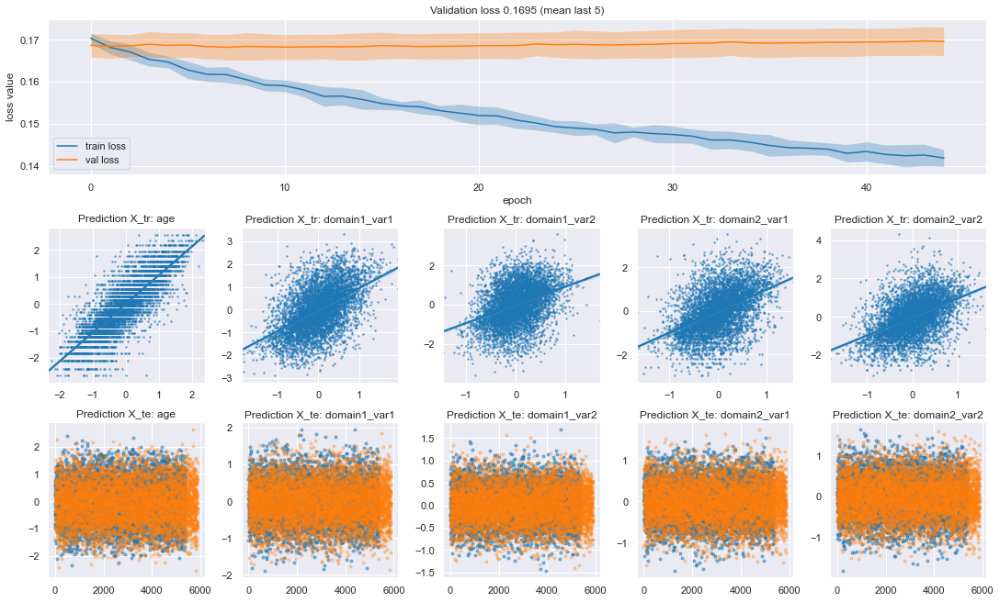

0.142569 0.169544 0.026975
0042/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


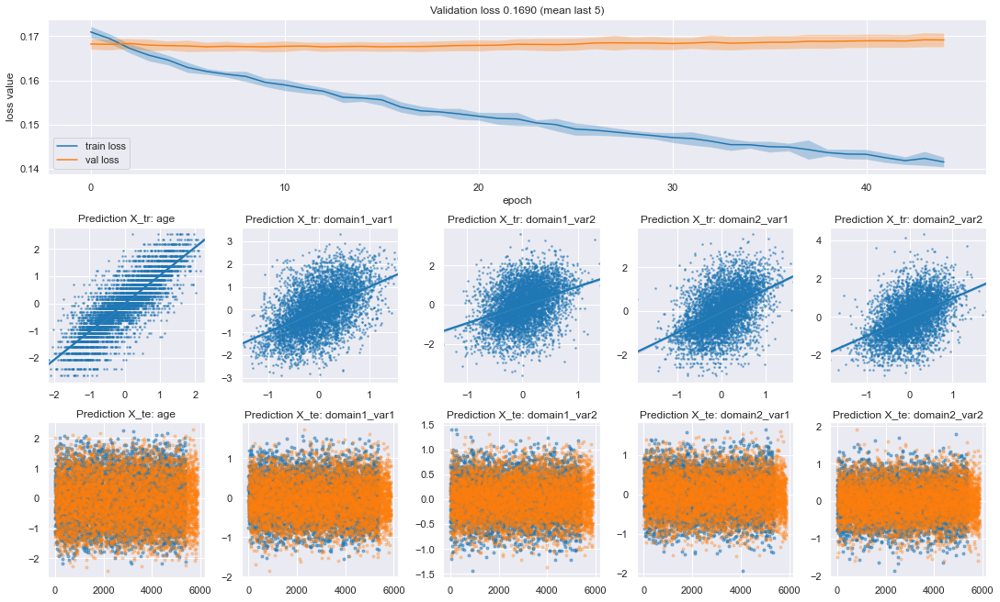

0.142278 0.169036 0.026758000000000004
0043/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


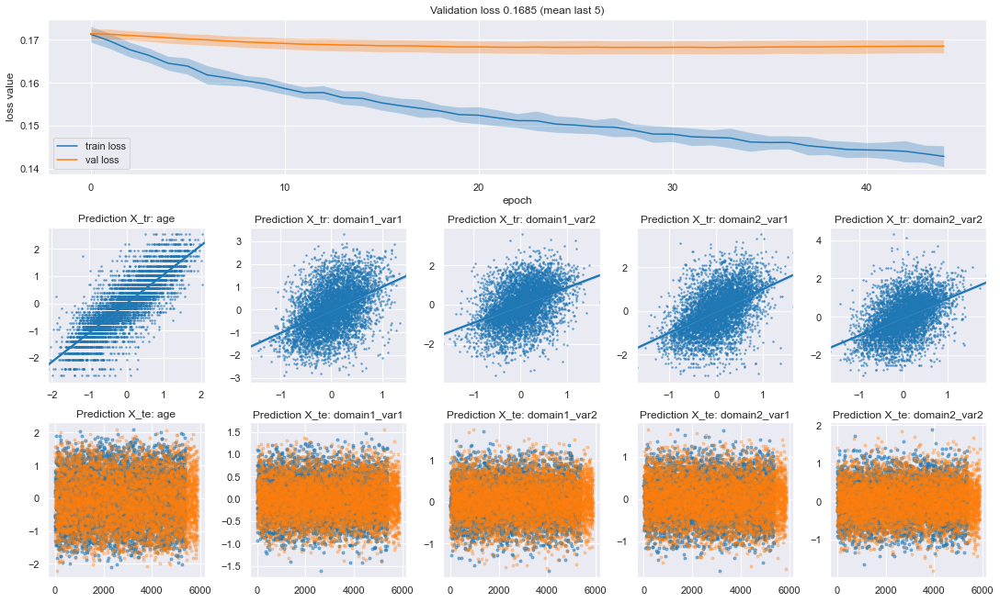

0.143768 0.168488 0.024719999999999992
0044/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (128, 16), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


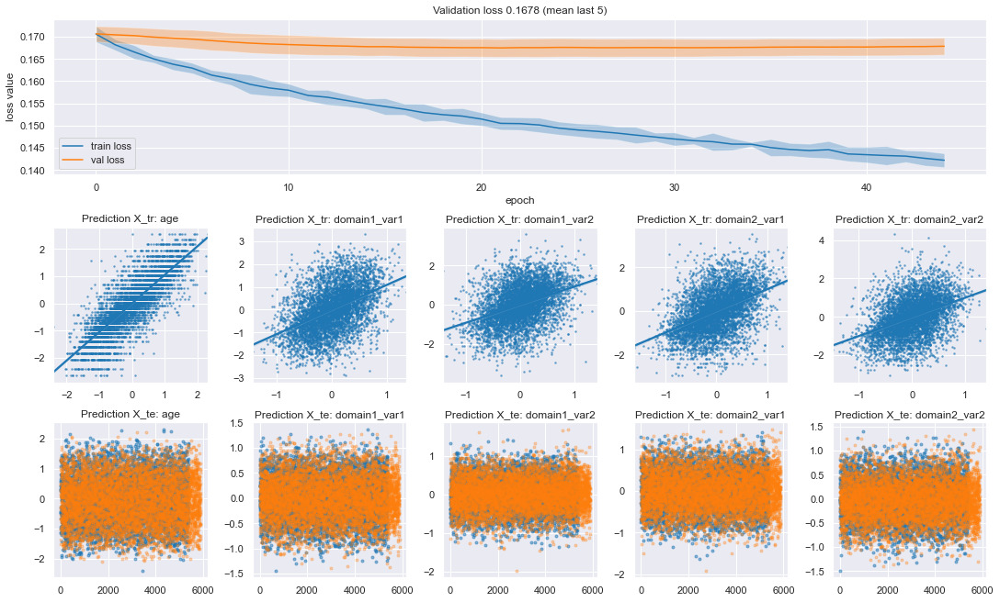

0.142914 0.167785 0.024870999999999976
0045/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


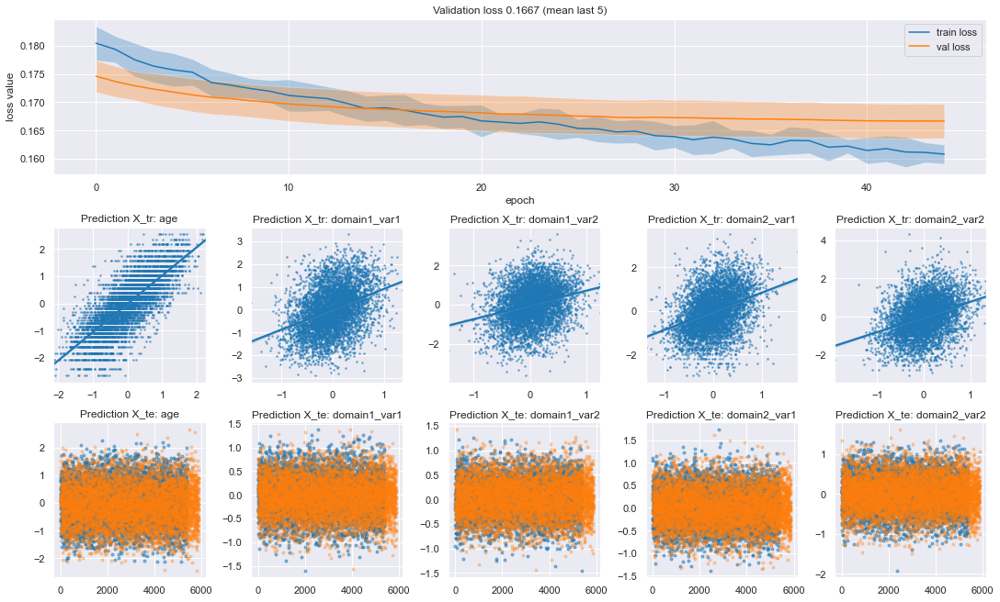

0.161263 0.166679 0.005416000000000004
0046/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


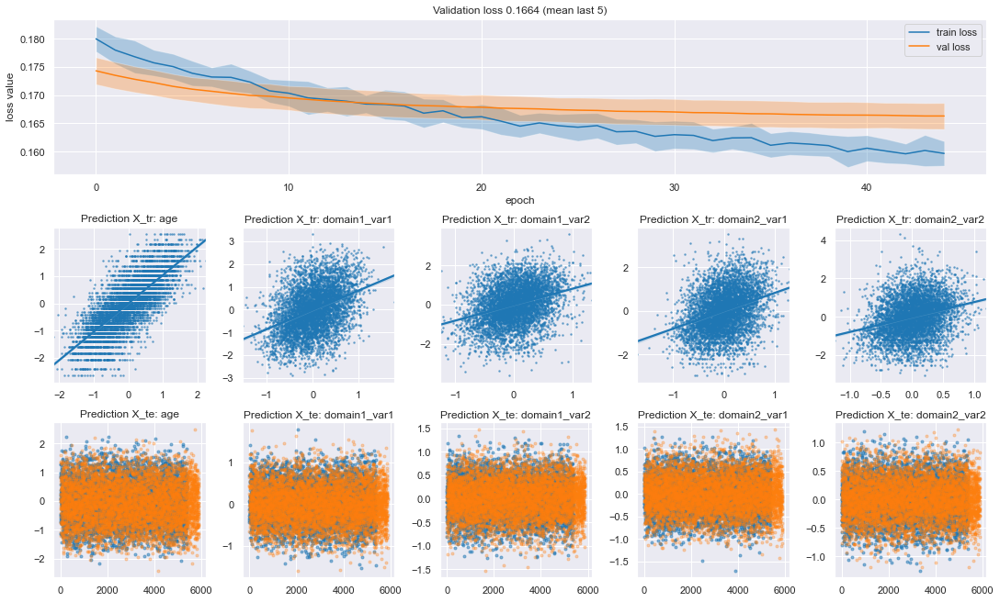

0.160034 0.166382 0.0063479999999999925
0047/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 981, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


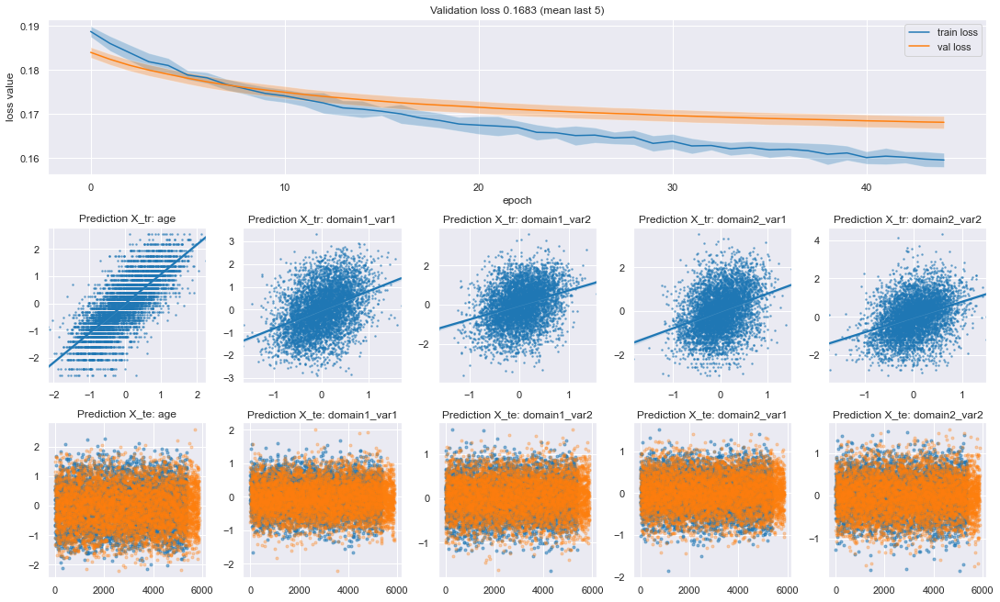

0.160002 0.168289 0.008286999999999989
0048/0048
{'batch_size': 64, 'epochs': 50, 'nn__activation': 'tanh', 'nn__dropout': 0.2, 'nn__hidden': (32,), 'nn__input_size': 1002, 'nn__kernel_initializer': 'uniform', 'nn__optimizer': 'adagrad', 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


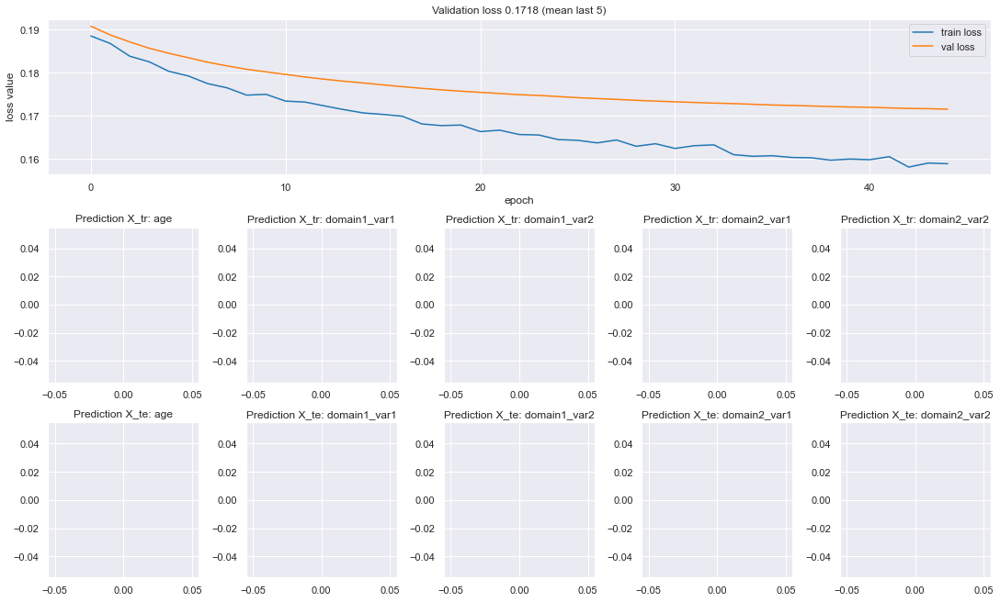

0.159336 0.17177 0.012434



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__optimizer,nn__use_batch,nn__use_dropout,pca,scaler
29,0.157191,0.161917,64,50,sigmoid,0.2,"(128, 16)",1654,uniform,adagrad,True,True,None,PowerTransformer()
32,0.163715,0.162002,64,50,sigmoid,0.2,"(32,)",1654,uniform,adagrad,True,True,None,RobustScaler()
33,0.163715,0.162153,64,50,sigmoid,0.2,"(32,)",1654,uniform,adagrad,True,True,None,PowerTransformer()
26,0.151517,0.162735,64,50,sigmoid,0.2,"(256, 64, 16)",981,uniform,adagrad,True,True,PCA(n_components=0.99),RobustScaler()
28,0.158470,0.162824,64,50,sigmoid,0.2,"(128, 16)",1654,uniform,adagrad,True,True,None,RobustScaler()
30,0.158182,0.163146,64,50,sigmoid,0.2,"(128, 16)",981,uniform,adagrad,True,True,PCA(n_components=0.99),RobustScaler()
34,0.164951,0.163700,64,50,sigmoid,0.2,"(32,)",981,uniform,adagrad,True,True,PCA(n_components=0.99),RobustScaler()
35,0.165489,0.164421,64,50,sigmoid,0.2,"(32,)",1002,uniform,adagrad,True,True,PCA(n_components=0.99),PowerTransformer()
9,0.152589,0.164716,64,50,softsign,0.2,"(32,)",1654,uniform,adagrad,True,True,None,PowerTransformer()
24,0.154706,0.164723,64,50,sigmoid,0.2,"(256, 64, 16)",1654,uniform,adagrad,True,True,None,RobustScaler()


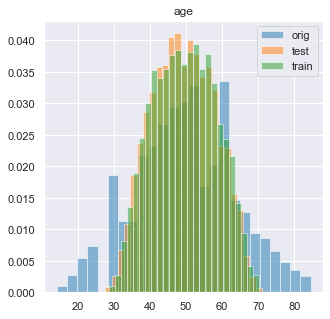

/anaconda3/envs/neuro/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/anaconda3/envs/neuro/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


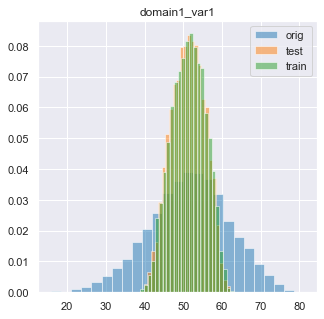

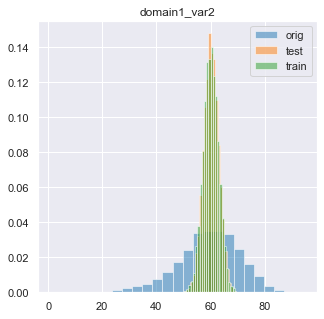

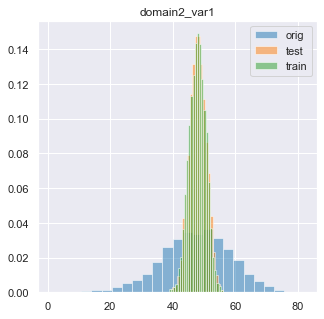

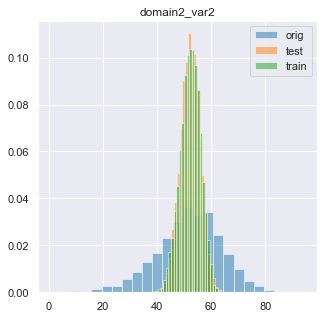

Best score for short_merge at 0.161917 


In [21]:
datasets_to_check = ['merge', 'short_merge']

for dataset_id in datasets_to_check:


    print('Starting with dataset %s' % dataset_id)
    pred_tr, pred_te, top_grid, idx, df_grid = run_prediction(targets, dataset_id=dataset_id)

    # Save predictions
    predictions = {}
    predictions['tr'] = pred_tr
    predictions['te'] = pred_te
    predictions['miss'] = idx

    # Extract overall score
    score_postfix = int(top_grid['te_mean']*10000)

    df_results_tr, df_results_te = save_results(
        predictions, scaler_targets, targets, test_id, feature_transform,
        sample_submission, dataset_id, score_postfix)

    plot_prediction_distributions(targets, scaler_targets, df_results_tr, df_results_te)
    
    # Feedback of overall score
    print('Best score for %s at %s ' % (dataset_id, top_grid['te_mean']))